# Loading

In [2]:
import scanpy as sc
import omicverse as ov
import scvelo as scv
from matplotlib import rcParams
from matplotlib.font_manager import FontProperties
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm

import matplotlib.pyplot as plt
from matplotlib import font_manager

font_dirs = ['Omicverse']  # The path to the custom font file.
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)

for font_file in font_files:
    font_manager.fontManager.addfont(font_file)

font_path = 'Arial.ttf'
front_prop = FontProperties(fname=font_path)


# 设置全局 DPI
plt.rcParams['figure.dpi'] = 300

In [3]:
sc_color=['#7CBB5F',
 '#368650',
 '#A499CC',
 '#5E4D9A',
 '#78C2ED',
 '#866017',
 '#9F987F',
 '#E0DFED',
 '#EF7B77',
 '#279AD7',
 '#F0EEF0',
 '#1F577B',
 '#A56BA7',
 '#E0A7C8',
 '#E069A6',
 '#941456',
 '#FCBC10',
 '#EAEFC5',
 '#01A0A7',
 '#75C8CC',
 '#F0D7BC',
 '#D5B26C',
 '#D5DA48',
 '#B6B812',
 '#9DC3C3',
 '#A89C92',
 '#FEE00C',
 '#FEF2A1']

# Dentategyrus Plots

In [4]:
import scvelo as scv
Dentategyrus_raw = sc.read_h5ad("Dentategyrus_raw.h5ad")
Dentategyrus_interpolated = sc.read_h5ad("Dentategyrus_interpolated.h5ad")
Dentategyrus_deleted = sc.read_h5ad("Dentategyrus_deleted.h5ad")
Dentategyrus=scv.datasets.dentategyrus()

In [5]:
Dentategyrus_raw.uns['clusters_colors'] = Dentategyrus.uns['clusters_colors']
Dentategyrus_interpolated.uns['clusters_colors'] = Dentategyrus.uns['clusters_colors']
Dentategyrus_deleted.uns['clusters_colors'] = Dentategyrus.uns['clusters_colors']

In [6]:
Dentategyrus_raw.obsm['X_umap'] = Dentategyrus_raw.obsm['X_mde']
Dentategyrus_interpolated.obsm['X_umap'] = Dentategyrus_interpolated.obsm['X_mde']
Dentategyrus_deleted.obsm['X_umap'] = Dentategyrus_deleted.obsm['X_mde']

In [7]:
from matplotlib import patheffects

ov.utils.embedding(Dentategyrus_raw,
                basis='X_umap',
           color=['clusters'],title='Dentategyrus CellType (Raw)',
                   frameon='small',show=False, legend_fontsize='small',
           wspace=0.4,cmap='Reds',
                  save='_Dentategyrus_raw.pdf',)
plt.show()

In [8]:
ov.utils.embedding(Dentategyrus_deleted,
                basis='X_umap',
           color=['clusters'],title='Dentategyrus CellType (Dropouts)',
                   frameon='small',show=False, legend_fontsize='small',
           wspace=0.4,cmap='Reds',
            save='_Dentategyrus_deleted.pdf',)
plt.show()

In [9]:
ov.utils.embedding(Dentategyrus_interpolated,
                basis='X_umap',
           color=['clusters'],title='Dentategyrus CellType (BulkTrajBlend)',
                   frameon='small',show=False, legend_fontsize='small',
           wspace=0.4,cmap='Reds',
                   save='_Dentategyrus_interpolated.pdf',)
plt.show()

In [ ]:
v0 = ov.single.pyVIA(adata=Dentategyrus_raw,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['nIPC','Neuroblast'],
                    dataset='group')
v0.run()

v1 = ov.single.pyVIA(adata=Dentategyrus_deleted,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['nIPC','Neuroblast'],
                    dataset='group')
v1.run()

v2 = ov.single.pyVIA(adata=Dentategyrus_interpolated,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['nIPC','Neuroblast'],
                    dataset='group')
v2.run()


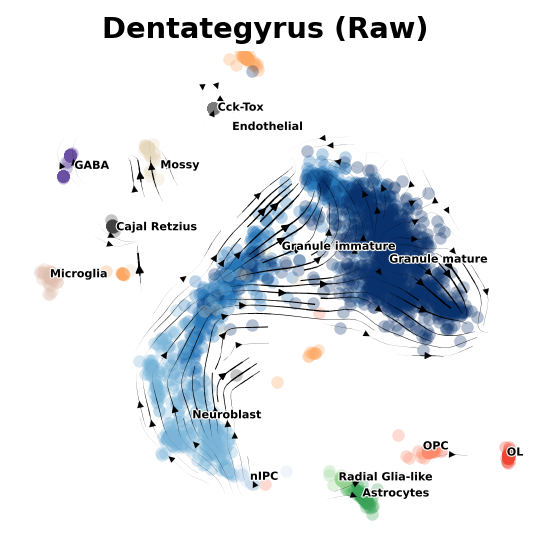

In [13]:
import matplotlib.pyplot as plt
fig,ax=v0.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('Dentategyrus (Raw)',fontsize=13,fontweight='bold')
fig.savefig('figures/via_Dentategyrus_raw.png',dpi=300,bbox_inches = 'tight')

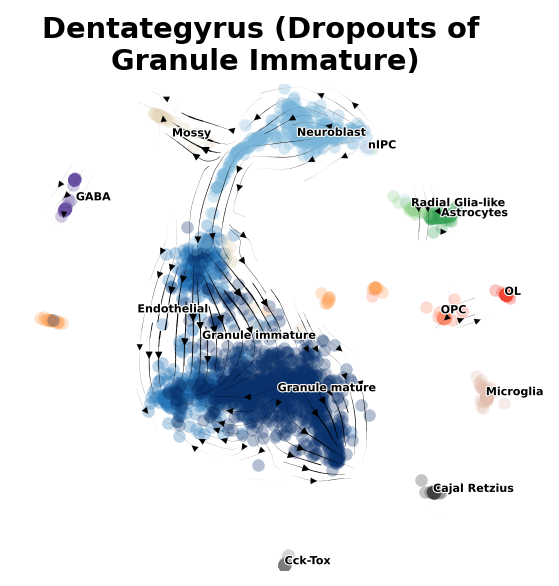

In [14]:
import matplotlib.pyplot as plt
fig,ax=v1.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('Dentategyrus (Dropouts of \nGranule Immature)',fontsize=13,fontweight='bold')
fig.savefig('figures/via_Dentategyrus_deleted.png',dpi=300,bbox_inches = 'tight')

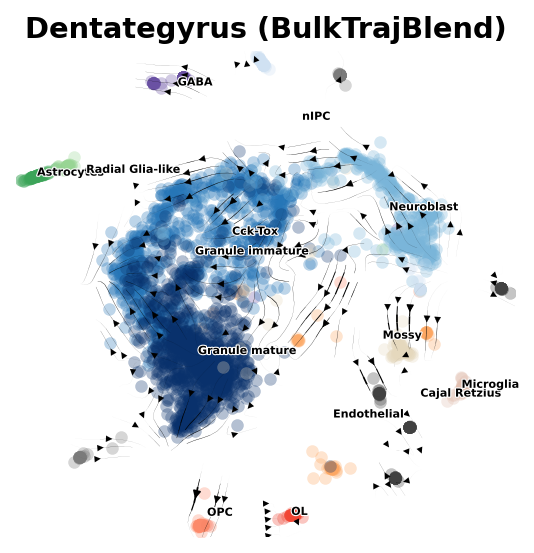

In [15]:
import matplotlib.pyplot as plt
fig,ax=v2.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('Dentategyrus (BulkTrajBlend)',fontsize=13,fontweight='bold')
fig.savefig('figures/via_Dentategyrus_interpolated.png',dpi=300,bbox_inches = 'tight')

In [16]:
v0.get_pseudotime(Dentategyrus_raw)
sc.pp.neighbors(Dentategyrus_raw,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(Dentategyrus_raw,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')

v1.get_pseudotime(Dentategyrus_deleted)
sc.pp.neighbors(Dentategyrus_deleted,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(Dentategyrus_deleted,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')

v2.get_pseudotime(Dentategyrus_interpolated)
sc.pp.neighbors(Dentategyrus_interpolated,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(Dentategyrus_interpolated,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')



...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


saving figure to file ./figures/scvelo_paga_Dentategyrus_raw.pdf


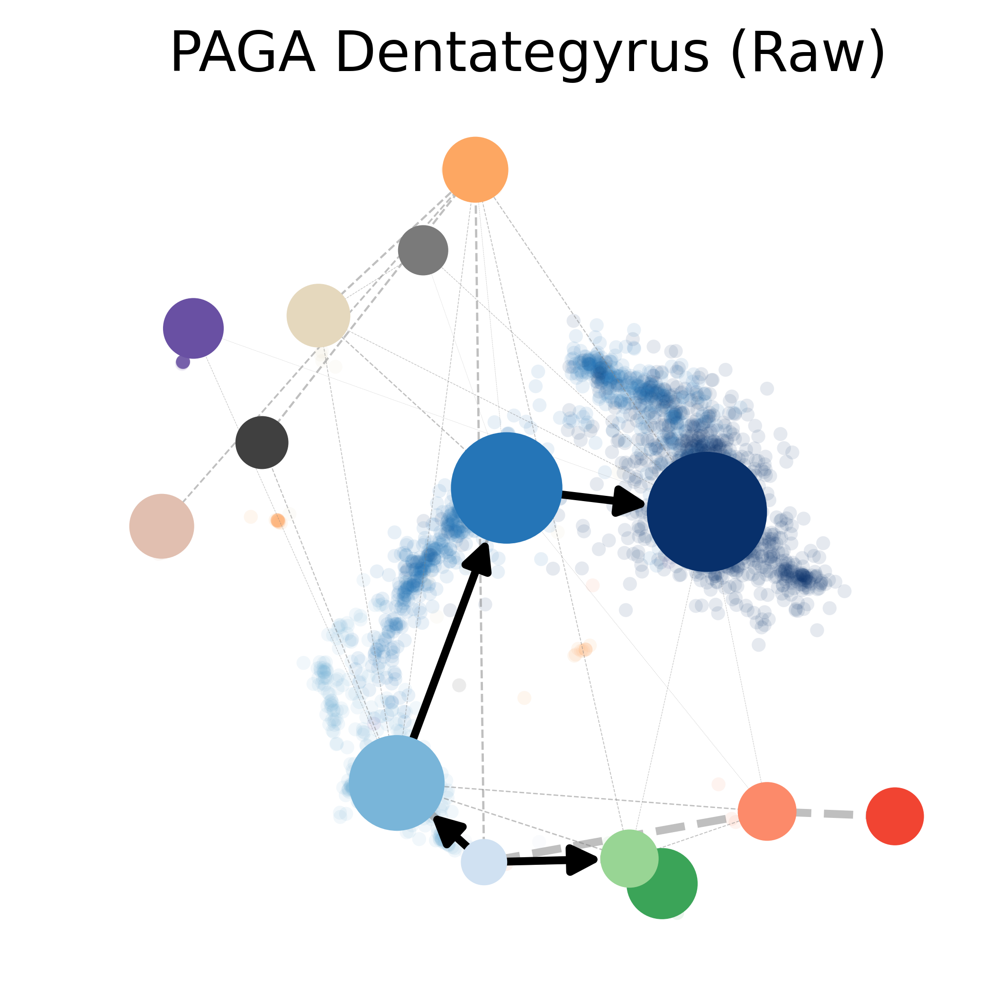

In [17]:
ov.utils.plot_paga(Dentategyrus_raw,basis='umap', size=50, alpha=.1,title='PAGA Dentategyrus (Raw)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
          save='paga_Dentategyrus_raw.pdf')


saving figure to file ./figures/scvelo_paga_Dentategyrus_deleted.pdf


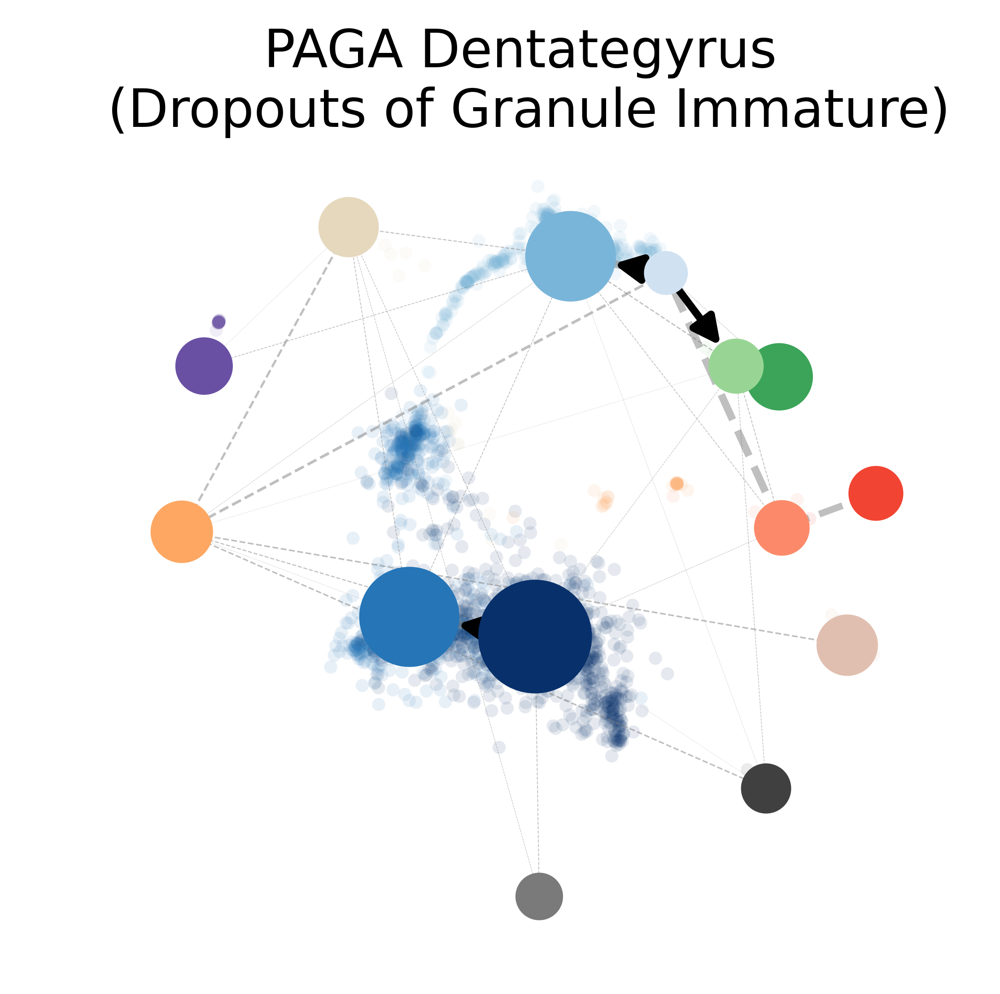

In [18]:
ov.utils.plot_paga(Dentategyrus_deleted,basis='umap', size=50, alpha=.1,title='PAGA Dentategyrus \n(Dropouts of Granule Immature)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
                  save='paga_Dentategyrus_deleted.pdf')

saving figure to file ./figures/scvelo_paga_Dentategyrus_interpolated.pdf


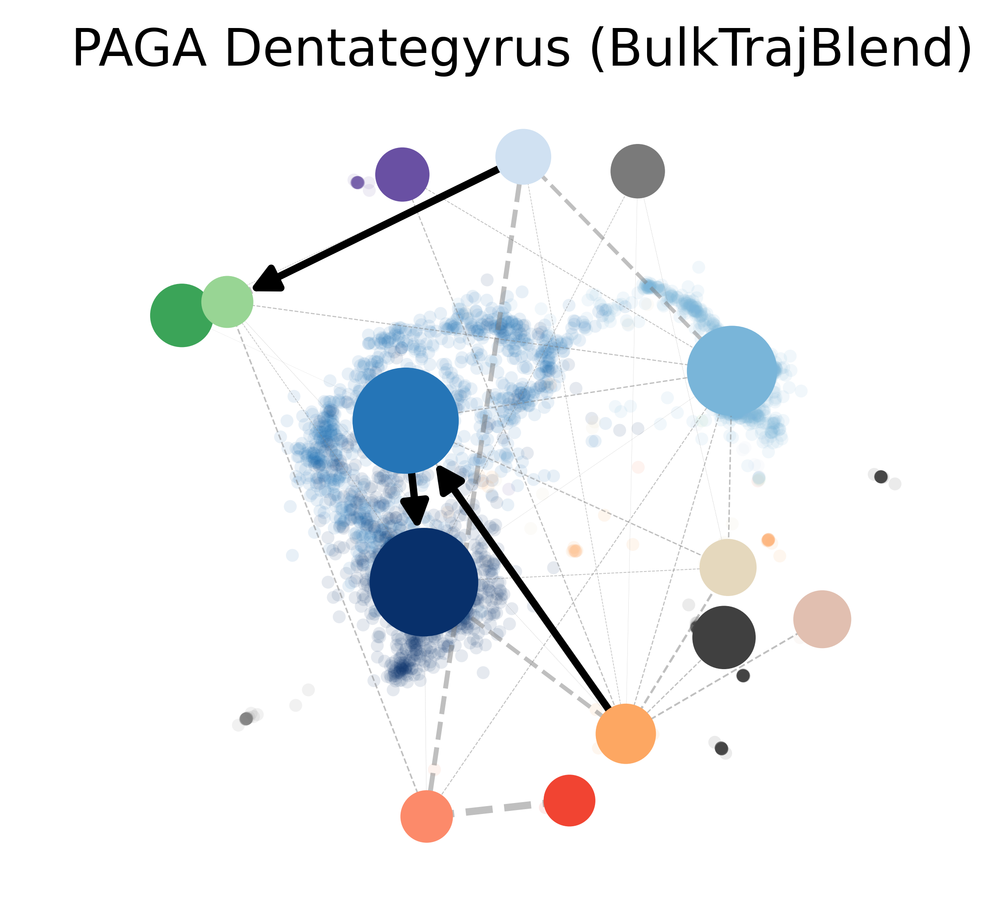

In [19]:
ov.utils.plot_paga(Dentategyrus_interpolated,basis='umap', size=50, alpha=.1,title='PAGA Dentategyrus (BulkTrajBlend)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
                  save='paga_Dentategyrus_interpolated.pdf')

# Pancreas Plots

In [32]:
Pancreas_raw = sc.read_h5ad("Pancreas_raw.h5ad")
Pancreas_interpolated = sc.read_h5ad("Pancreas_interpolated.h5ad")
Pancreas_deleted = sc.read_h5ad("Pancreas_deleted.h5ad")

import scltnn
Pancreas=scltnn.datasets.Pancreas()

Pancreas_raw.uns['clusters_colors'] = Pancreas.uns['clusters_colors']
Pancreas_interpolated.uns['clusters_colors'] = Pancreas.uns['clusters_colors']
Pancreas_deleted.uns['clusters_colors'] = Pancreas.uns['clusters_colors']


In [33]:
new_order = ['Ductal','Ngn3 low EP','Ngn3 high EP','Pre-endocrine','Beta','Alpha','Delta','Epsilon']
Pancreas_interpolated.obs['clusters'] = Pancreas_interpolated.obs['clusters'].cat.reorder_categories(new_order)

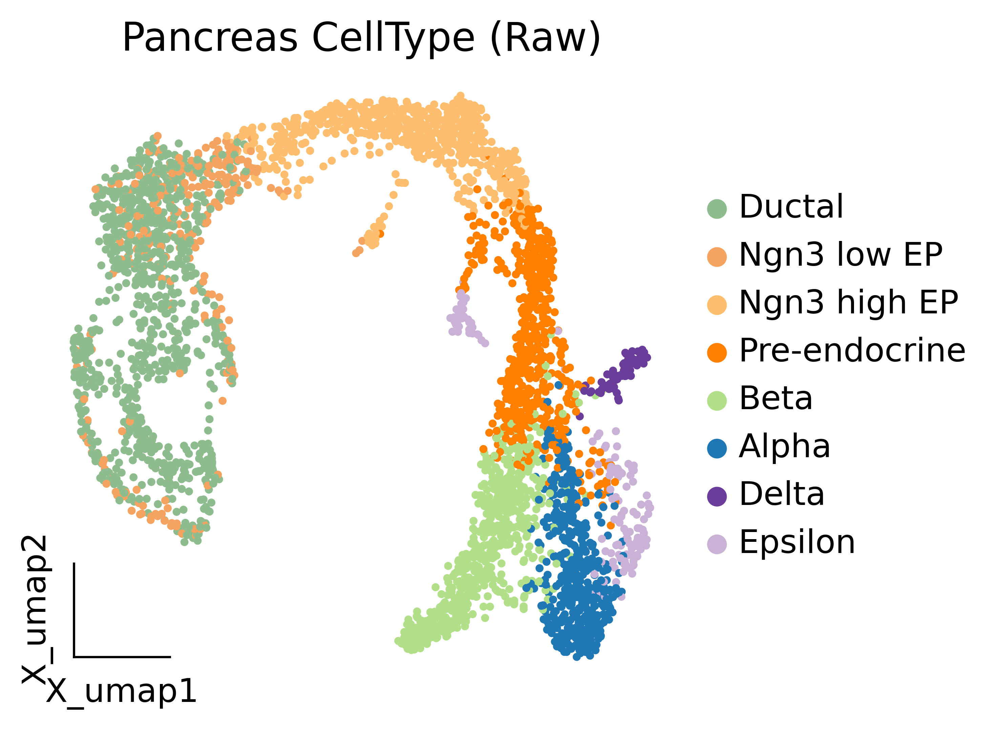

In [34]:
ov.utils.embedding(Pancreas_raw,
                basis='X_umap',
           color=['clusters'],title='Pancreas CellType (Raw)',
                   frameon='small',show=True, legend_fontsize='small',
           wspace=0.4,cmap='Reds',
                   save='_Pancreas_raw.pdf',)
plt.show()

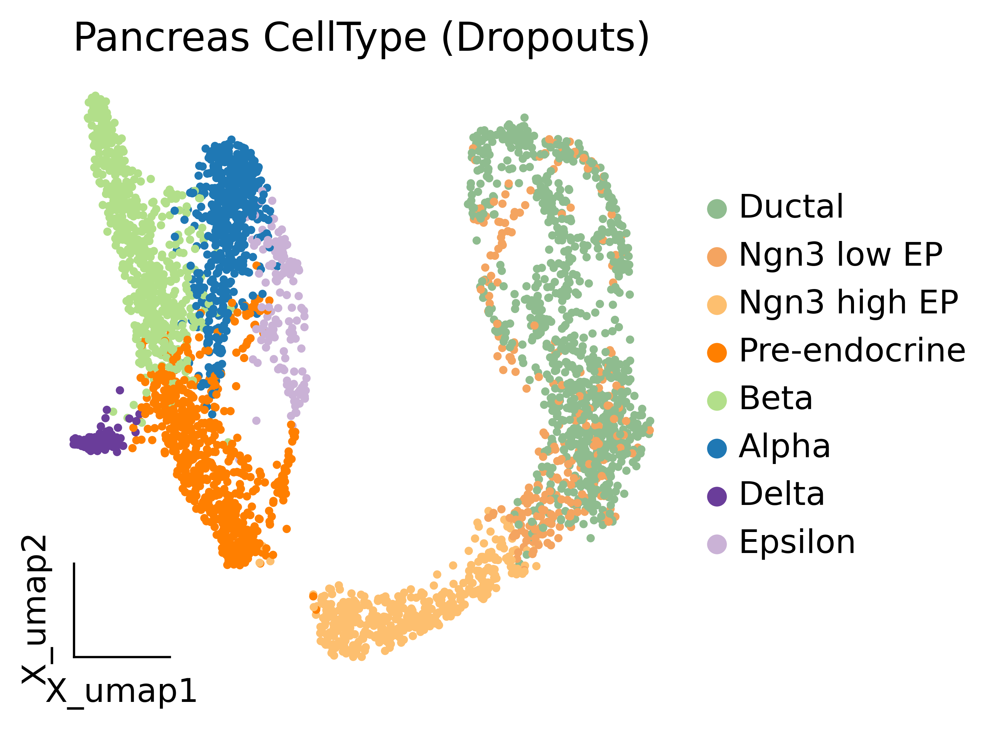

In [35]:
ov.utils.embedding(Pancreas_deleted,
                basis='X_umap',
           color=['clusters'],title='Pancreas CellType (Dropouts)',
                   frameon='small',show=True, legend_fontsize='small',
           wspace=0.4,cmap='Reds',
                   save='_Pancreas_deleted.pdf',)
plt.show()

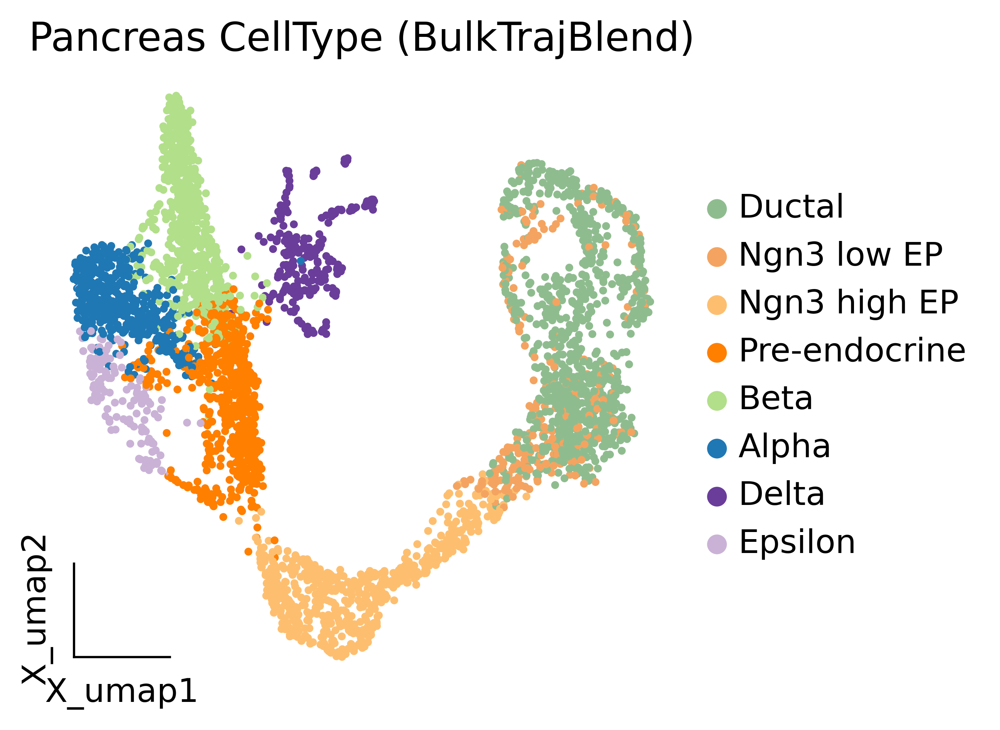

In [36]:
ov.utils.embedding(Pancreas_interpolated,
                basis='X_umap',
           color=['clusters'],title='Pancreas CellType (BulkTrajBlend)',
                   frameon='small',show=True, legend_fontsize='small',
           wspace=0.4,cmap='Reds_r',
                   save='_Pancreas_interpolated.pdf',)
plt.show()

In [37]:
v0 = ov.single.pyVIA(adata=Pancreas_raw,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['Ductal'],
                    dataset='group')
v0.run()

v1 = ov.single.pyVIA(adata=Pancreas_deleted,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['Ductal'],
                    dataset='group')
v1.run()

v2 = ov.single.pyVIA(adata=Pancreas_interpolated,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['Ductal'],
                    dataset='group')
v2.run()


2024-06-12 19:42:42.241629	Running VIA over input data of 3696 (samples) x 100 (features)
2024-06-12 19:42:42.241766	Knngraph has 20 neighbors
2024-06-12 19:42:43.760460	Finished global pruning of 20-knn graph used for clustering at level of 0.15. Kept 45.2 % of edges. 
2024-06-12 19:42:43.774910	Number of connected components used for clustergraph  is 1
2024-06-12 19:42:43.863740	Commencing community detection
2024-06-12 19:42:44.108975	Finished running Leiden algorithm. Found 120 clusters.
2024-06-12 19:42:44.110001	Merging 103 very small clusters (<10)
2024-06-12 19:42:44.111385	Finished detecting communities. Found 17 communities
2024-06-12 19:42:44.111599	Making cluster graph. Global cluster graph pruning level: 0.15
2024-06-12 19:42:44.117368	Graph has 1 connected components before pruning
2024-06-12 19:42:44.118572	Graph has 2 connected components after pruning
2024-06-12 19:42:44.119365	Graph has 1 connected components after reconnecting
2024-06-12 19:42:44.119782	0.0% links tr

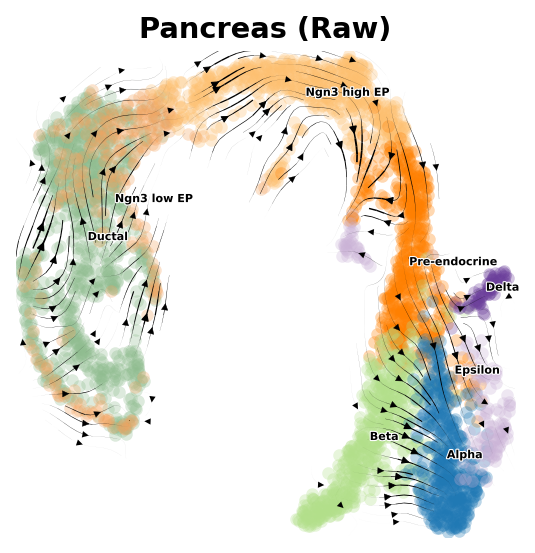

In [38]:
import matplotlib.pyplot as plt
fig,ax=v0.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('Pancreas (Raw)',fontsize=13,fontweight='bold')
fig.savefig('figures/via_Pancreas_raw.png',dpi=300,bbox_inches = 'tight')

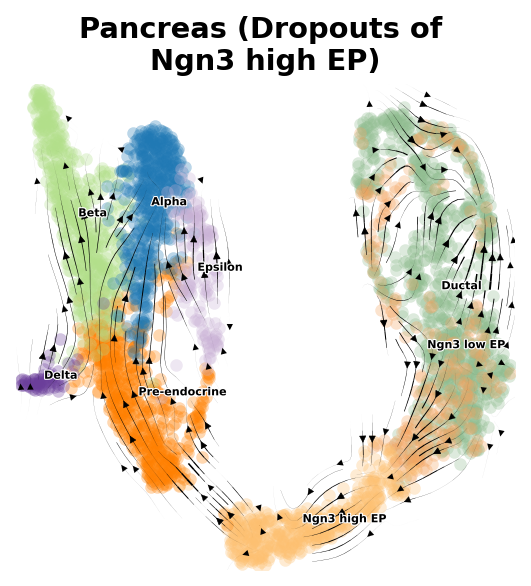

In [39]:
import matplotlib.pyplot as plt
fig,ax=v1.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('Pancreas (Dropouts of \nNgn3 high EP)',fontsize=13,fontweight='bold')
fig.savefig('figures/via_Pancreas_deleted.png',dpi=300,bbox_inches = 'tight')

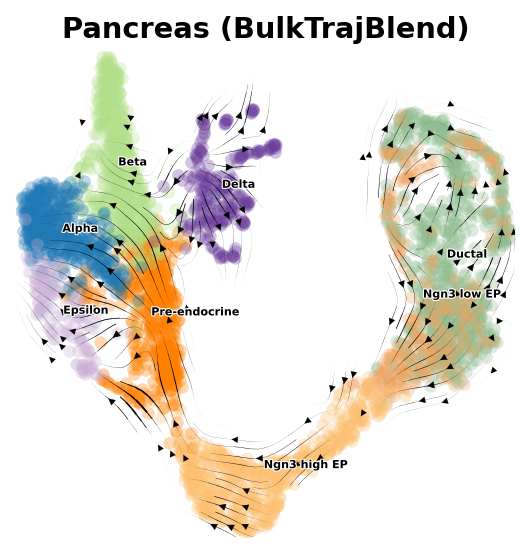

In [40]:
import matplotlib.pyplot as plt
fig,ax=v2.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('Pancreas (BulkTrajBlend)',fontsize=13,fontweight='bold')
fig.savefig('figures/via_Pancreas_interpolated.png',dpi=300,bbox_inches = 'tight')

In [41]:
v0.get_pseudotime(Pancreas_raw)
sc.pp.neighbors(Pancreas_raw,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(Pancreas_raw,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')

v1.get_pseudotime(Pancreas_deleted)
sc.pp.neighbors(Pancreas_deleted,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(Pancreas_deleted,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')

v2.get_pseudotime(Pancreas_interpolated)
sc.pp.neighbors(Pancreas_interpolated,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(Pancreas_interpolated,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')



...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


saving figure to file ./figures/scvelo_paga_Pancreas_raw.pdf


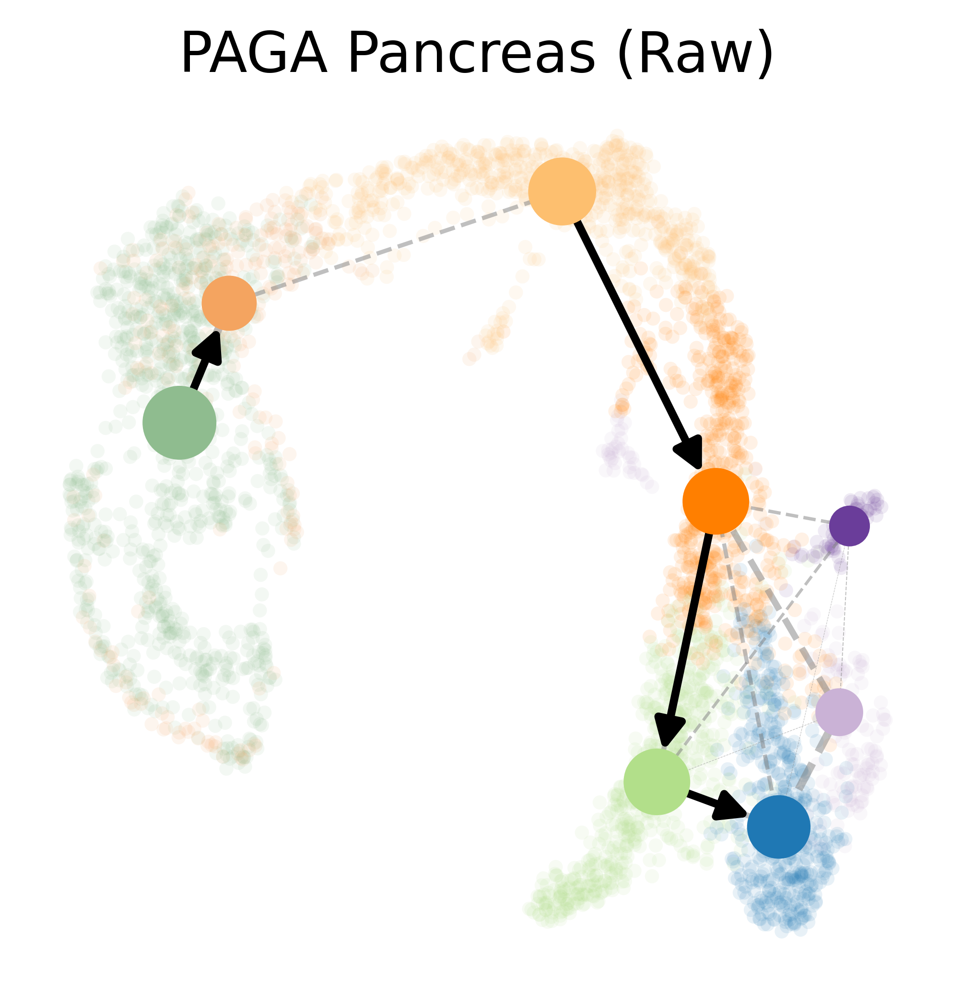

In [42]:
ov.utils.plot_paga(Pancreas_raw,basis='umap', size=50, alpha=.1,title='PAGA Pancreas (Raw)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
                   save='paga_Pancreas_raw.pdf')

saving figure to file ./figures/scvelo_paga_Pancreas_deleted.pdf


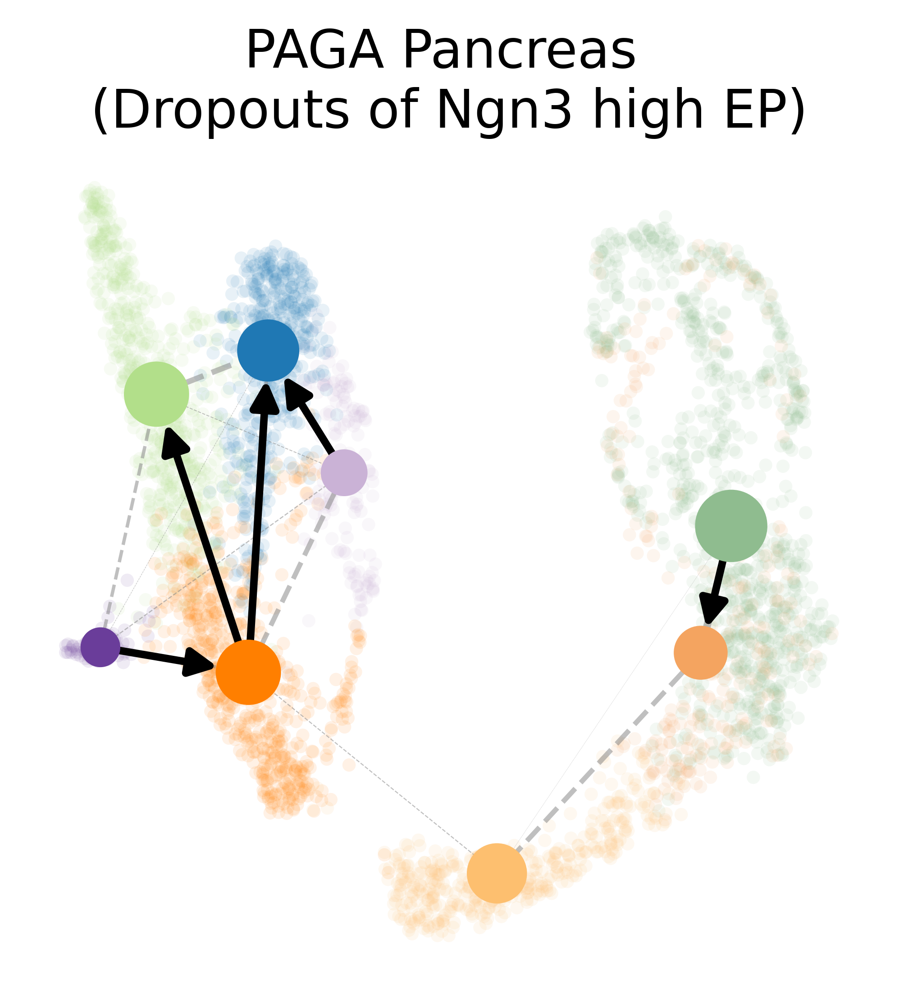

In [43]:
ov.utils.plot_paga(Pancreas_deleted,basis='umap', size=50, alpha=.1,title='PAGA Pancreas \n(Dropouts of Ngn3 high EP)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
                   save='paga_Pancreas_deleted.pdf')

saving figure to file ./figures/scvelo_paga_Pancreas_interpolated.pdf


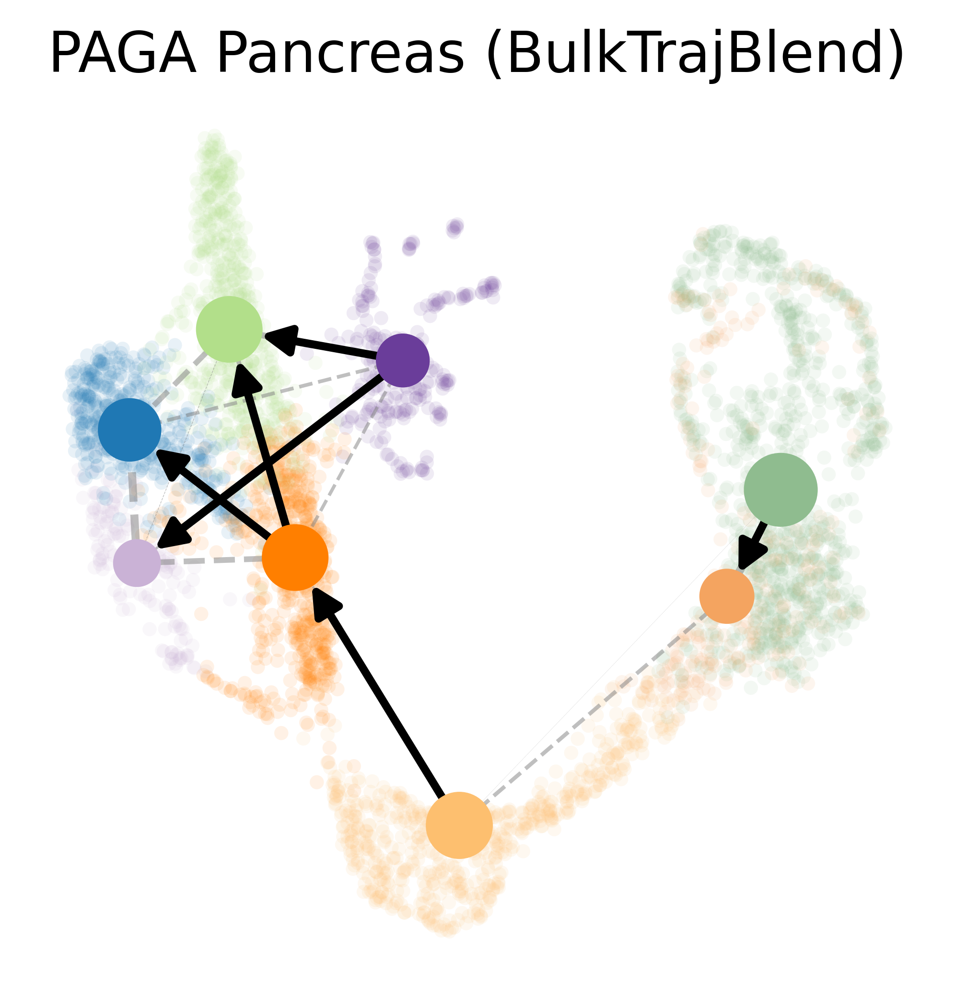

In [44]:
ov.utils.plot_paga(Pancreas_interpolated,basis='umap', size=50, alpha=.1,title='PAGA Pancreas (BulkTrajBlend)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
                   save='paga_Pancreas_interpolated.pdf')

# BoneMarrow Plots

In [46]:
BoneMarrow_raw = sc.read_h5ad("BoneMarrow_raw.h5ad")
BoneMarrow_interpolated = sc.read_h5ad("BoneMarrow_interpolated.h5ad")
BoneMarrow_deleted = sc.read_h5ad("BoneMarrow_deleted.h5ad")

BoneMarrow=scltnn.datasets.BoneMarrow()
BoneMarrow.uns['clusters_colors'] = ['#E0A7C8', '#A56BA7', '#a6d854', '#EF7B77', '#941456', '#e5c494',
       '#e41a1c', '#a6cee3', '#4daf4a', '#ff7f00']
BoneMarrow_raw.uns['clusters_colors'] = BoneMarrow.uns['clusters_colors']
BoneMarrow_interpolated.uns['clusters_colors'] = BoneMarrow.uns['clusters_colors']
BoneMarrow_deleted.uns['clusters_colors'] = BoneMarrow.uns['clusters_colors']

In [47]:
new_order = [
    'HSC_1','HSC_2','Ery_1','Mono_1','Precursors',
    'CLP','Mono_2','DCs','Ery_2','Mega',
]
BoneMarrow_interpolated.obs['clusters'] = BoneMarrow_interpolated.obs['clusters'].cat.reorder_categories(new_order)

In [48]:
sc.pp.neighbors(BoneMarrow_interpolated, n_neighbors=15, n_pcs=50,)
sc.tl.umap(BoneMarrow_interpolated)

sc.pp.neighbors(BoneMarrow_deleted, n_neighbors=15, n_pcs=50,)
sc.tl.umap(BoneMarrow_deleted)

In [49]:
#BoneMarrow_raw.obsm['X_umap'] = BoneMarrow_raw.obsm['X_mde']
#BoneMarrow_interpolated.obsm['X_umap'] = BoneMarrow_interpolated.obsm['X_mde']
#BoneMarrow_deleted.obsm['X_umap'] = BoneMarrow_deleted.obsm['X_mde']

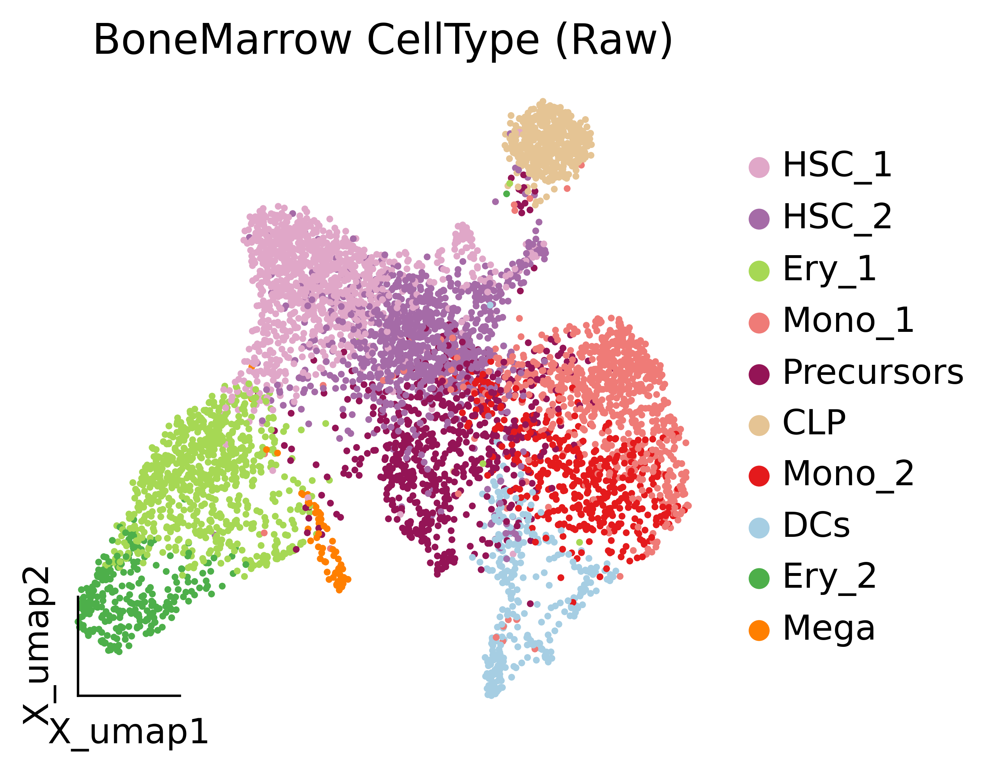

In [50]:
ov.utils.embedding(BoneMarrow_raw,
                basis='X_umap',
           color=['clusters'],title='BoneMarrow CellType (Raw)',
                   frameon='small',show=True, legend_fontsize='small',
           wspace=0.4,cmap='Reds' ,
                   save='_BoneMarrow_raw.pdf',)
plt.show()

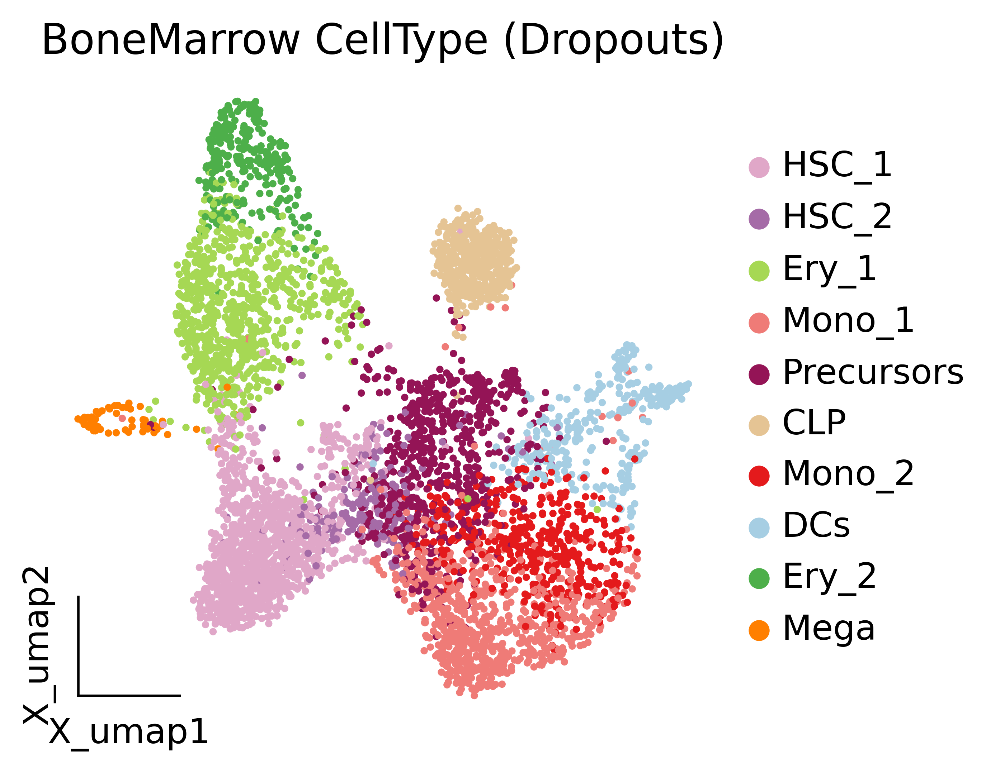

In [51]:
ov.utils.embedding(BoneMarrow_deleted,
                basis='X_umap',
           color=['clusters'],title='BoneMarrow CellType (Dropouts)',
                   frameon='small',show=True, legend_fontsize='small',
           wspace=0.4,cmap='Reds' ,
                   save='_BoneMarrow_deleted.pdf',)
plt.show()

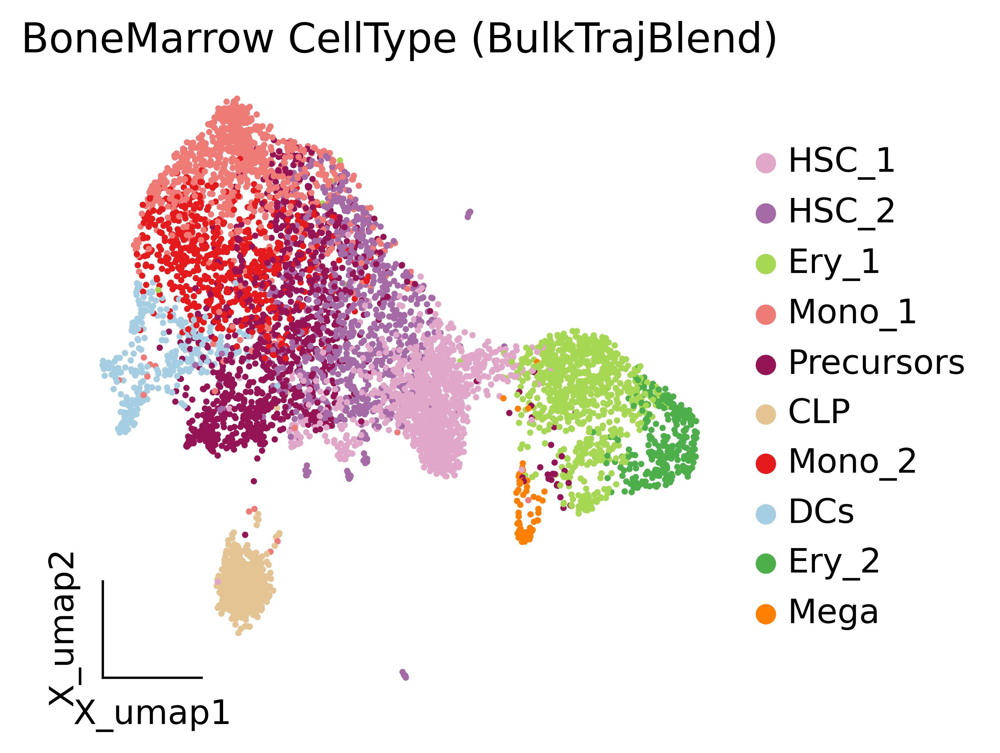

In [52]:
ov.utils.embedding(BoneMarrow_interpolated,
                basis='X_umap',
           color=['clusters'],title='BoneMarrow CellType (BulkTrajBlend)',
                   frameon='small',show=True, legend_fontsize='small',
           wspace=0.4,cmap='Reds' ,
                   save='_BoneMarrow_interpolated.pdf',)
plt.show()

In [53]:
v0 = ov.single.pyVIA(adata=BoneMarrow_raw,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['HSC_1'],
                    dataset='group')
v0.run()

v1 = ov.single.pyVIA(adata=BoneMarrow_deleted,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['HSC_1'],
                    dataset='group')
v1.run()

v2 = ov.single.pyVIA(adata=BoneMarrow_interpolated,adata_key='X_pca',adata_ncomps=100, basis='X_umap',
                         clusters='clusters',knn=20,random_seed=4,root_user=['HSC_1'],
                    dataset='group')
v2.run()


2024-06-12 19:44:46.431590	Running VIA over input data of 5780 (samples) x 100 (features)
2024-06-12 19:44:46.431713	Knngraph has 20 neighbors
2024-06-12 19:44:49.765658	Finished global pruning of 20-knn graph used for clustering at level of 0.15. Kept 43.0 % of edges. 
2024-06-12 19:44:49.788323	Number of connected components used for clustergraph  is 1
2024-06-12 19:44:49.942093	Commencing community detection
2024-06-12 19:44:50.379966	Finished running Leiden algorithm. Found 181 clusters.
2024-06-12 19:44:50.381571	Merging 166 very small clusters (<10)
2024-06-12 19:44:50.383743	Finished detecting communities. Found 15 communities
2024-06-12 19:44:50.384059	Making cluster graph. Global cluster graph pruning level: 0.15
2024-06-12 19:44:50.393456	Graph has 1 connected components before pruning
2024-06-12 19:44:50.394667	Graph has 2 connected components after pruning
2024-06-12 19:44:50.395442	Graph has 1 connected components after reconnecting
2024-06-12 19:44:50.395896	0.0% links tr

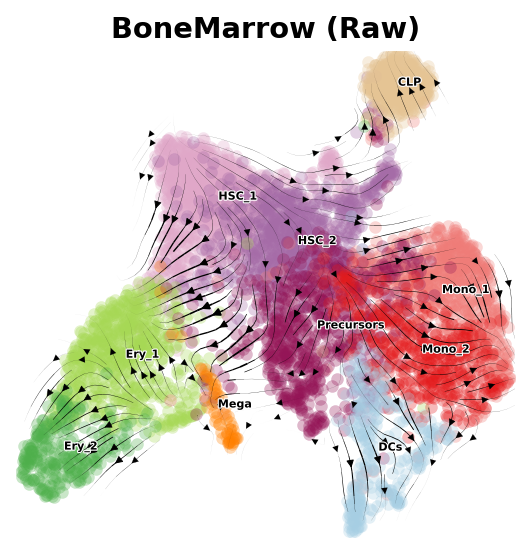

In [54]:
import matplotlib.pyplot as plt
fig,ax=v0.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('BoneMarrow (Raw)',fontsize=13,fontweight='bold',)
fig.savefig('figures/via_BoneMarrow_raw.png',dpi=300,bbox_inches = 'tight')

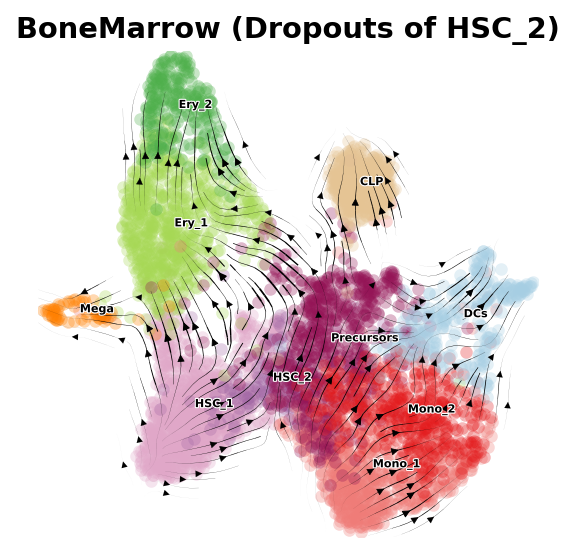

In [55]:
import matplotlib.pyplot as plt
fig,ax=v1.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5,)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('BoneMarrow (Dropouts of HSC_2)',fontsize=13,fontweight='bold',)
fig.savefig('figures/via_BoneMarrow_deleted.png',dpi=300,bbox_inches = 'tight')

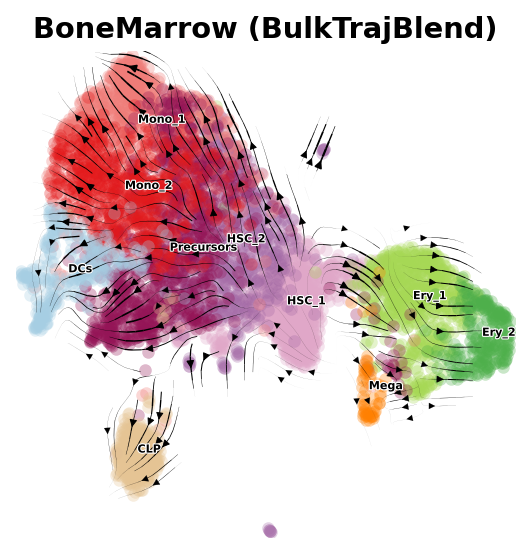

In [56]:
import matplotlib.pyplot as plt
fig,ax=v2.plot_stream(basis='X_umap',clusters='clusters',
               density_grid=0.8, scatter_size=30, scatter_alpha=0.3, linewidth=0.5,)
fig.set_size_inches(4, 4)  # 设置图像大小为4x4
plt.title('BoneMarrow (BulkTrajBlend)',fontsize=13,fontweight='bold',)
fig.savefig('figures/via_BoneMarrow_interpolated.png',dpi=300,bbox_inches = 'tight')

In [57]:
v0.get_pseudotime(BoneMarrow_raw)
sc.pp.neighbors(BoneMarrow_raw,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(BoneMarrow_raw,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')

v1.get_pseudotime(BoneMarrow_deleted)
sc.pp.neighbors(BoneMarrow_deleted,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(BoneMarrow_deleted,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')

v2.get_pseudotime(BoneMarrow_interpolated)
sc.pp.neighbors(BoneMarrow_interpolated,n_neighbors= 15,use_rep='X_pca')
ov.utils.cal_paga(BoneMarrow_interpolated,use_time_prior='pt_via',vkey='paga',
                 groups='clusters')



...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)
...the pseudotime of VIA added to AnnData obs named `pt_via`
running PAGA using priors: ['pt_via']
    finished
added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


saving figure to file ./figures/scvelo_paga_BoneMarrow_raw.pdf


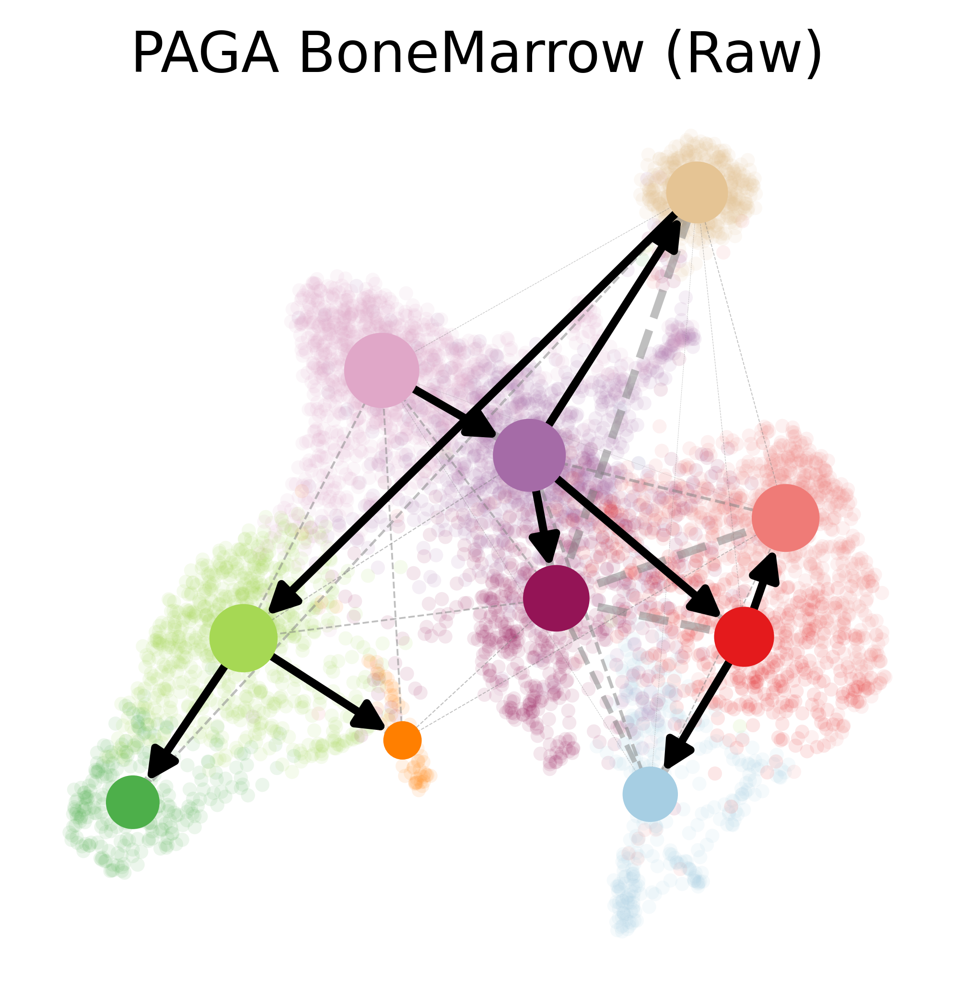

In [58]:
ov.utils.plot_paga(BoneMarrow_raw,basis='umap', size=50, alpha=.1,title='PAGA BoneMarrow (Raw)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
            save='paga_BoneMarrow_raw.pdf')

saving figure to file ./figures/scvelo_paga_BoneMarrow_deleted.pdf


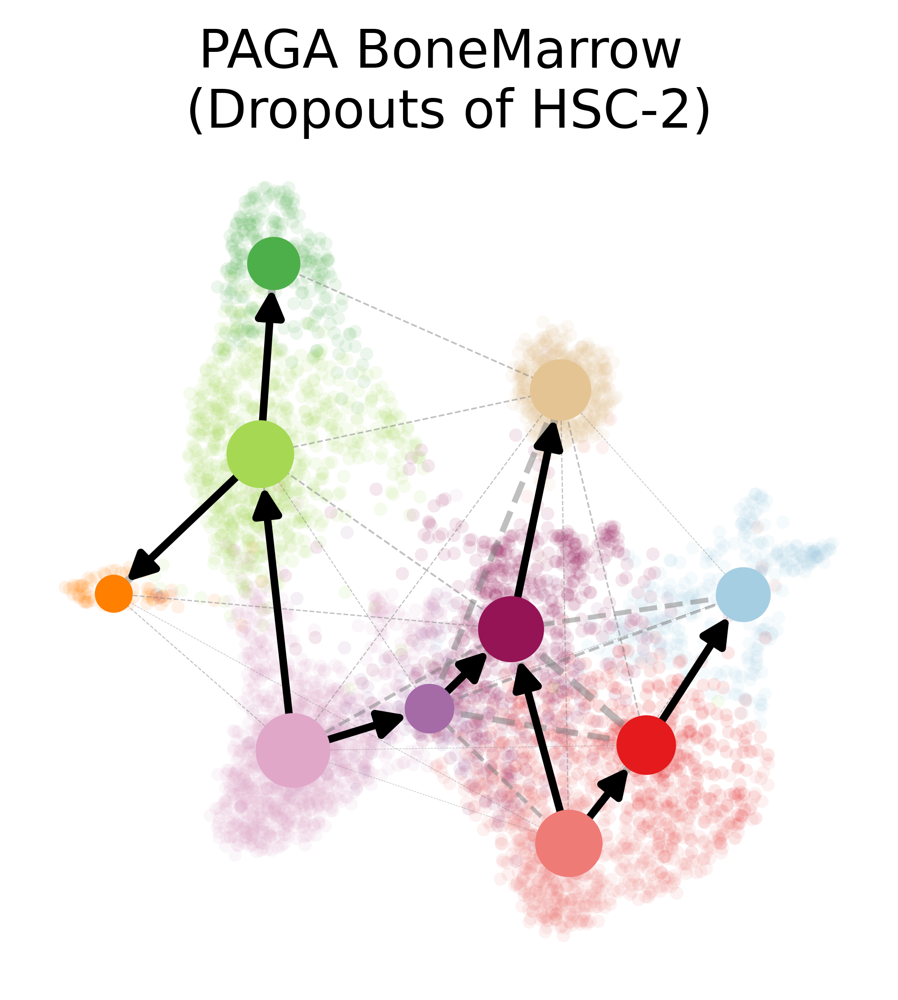

In [59]:
ov.utils.plot_paga(BoneMarrow_deleted,basis='umap', size=50, alpha=.1,title='PAGA BoneMarrow \n(Dropouts of HSC-2)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
            save='paga_BoneMarrow_deleted.pdf')

saving figure to file ./figures/scvelo_paga_BoneMarrow_interpolated.pdf


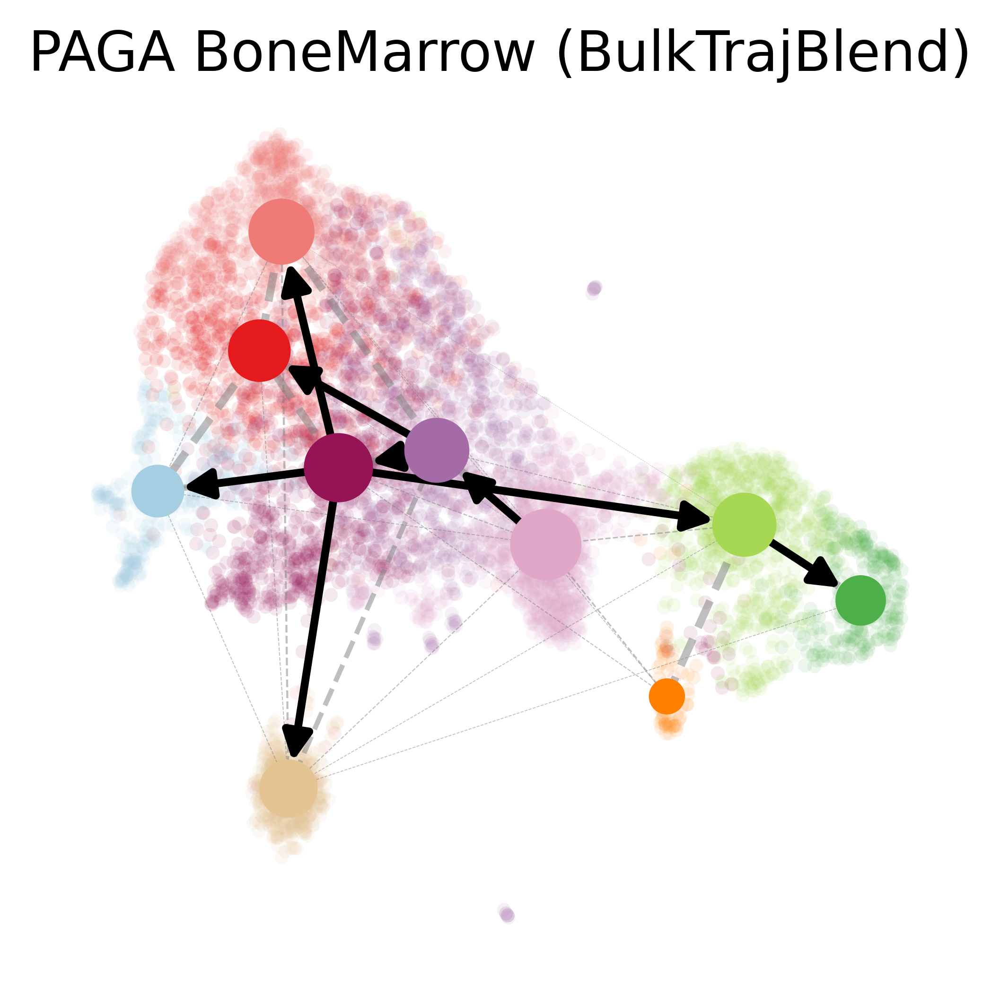

In [60]:
ov.utils.plot_paga(BoneMarrow_interpolated,basis='umap', size=50, alpha=.1,title='PAGA BoneMarrow (BulkTrajBlend)',
            min_edge_width=2, node_size_scale=1.5,show=True,legend_loc=False,figsize=(4,4),dpi=300,fontsize=13,fontweight='bold',
            save='paga_BoneMarrow_interpolated.pdf')

# Calculation

## Dentategyrus

In [61]:
import pandas as pd
raw_transitions_Dentategyrus=pd.DataFrame(Dentategyrus_raw.uns['paga']['transitions_confidence'].toarray(),
            index=Dentategyrus_raw.obs['clusters'].cat.categories,
            columns=Dentategyrus_raw.obs['clusters'].cat.categories)
print(raw_transitions_Dentategyrus)

                  Astrocytes  Cajal Retzius  Cck-Tox  Endothelial  GABA  \
Astrocytes               0.0            0.0      0.0          0.0   0.0   
Cajal Retzius            0.0            0.0      0.0          0.0   0.0   
Cck-Tox                  0.0            0.0      0.0          0.0   0.0   
Endothelial              0.0            0.0      0.0          0.0   0.0   
GABA                     0.0            0.0      0.0          0.0   0.0   
Granule immature         0.0            0.0      0.0          0.0   0.0   
Granule mature           0.0            0.0      0.0          0.0   0.0   
Microglia                0.0            0.0      0.0          0.0   0.0   
Mossy                    0.0            0.0      0.0          0.0   0.0   
Neuroblast               0.0            0.0      0.0          0.0   0.0   
OL                       0.0            0.0      0.0          0.0   0.0   
OPC                      0.0            0.0      0.0          0.0   0.0   
Radial Glia-like         

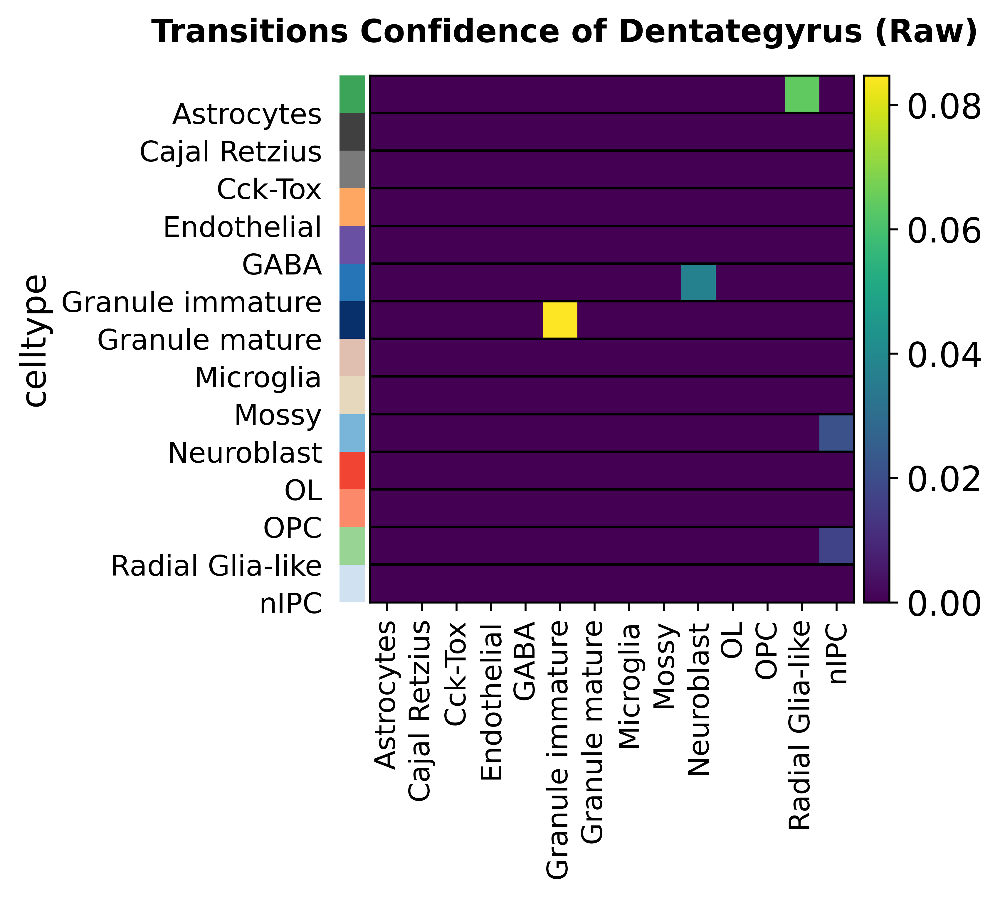

In [62]:
from anndata import AnnData
import matplotlib.colors as mcolors

raw_transitions_adata = AnnData(raw_transitions_Dentategyrus)
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs.index
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs['celltype'].astype('category')
raw_transitions_adata.uns['celltype_colors'] = Dentategyrus.uns['clusters_colors']

sc.pl.heatmap(raw_transitions_adata,
              var_names=raw_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,
             )

fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of Dentategyrus (Raw)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_Dentategyrus_raw.pdf',dpi=300,bbox_inches = 'tight')

plt.show()

In [63]:
delete_transitions_Dentategyrus=pd.DataFrame(Dentategyrus_deleted.uns['paga']['transitions_confidence'].toarray(),
            index=Dentategyrus_deleted.obs['clusters'].cat.categories,
            columns=Dentategyrus_deleted.obs['clusters'].cat.categories)
print(delete_transitions_Dentategyrus)

                  Astrocytes  Cajal Retzius  Cck-Tox  Endothelial  GABA  \
Astrocytes               0.0            0.0      0.0          0.0   0.0   
Cajal Retzius            0.0            0.0      0.0          0.0   0.0   
Cck-Tox                  0.0            0.0      0.0          0.0   0.0   
Endothelial              0.0            0.0      0.0          0.0   0.0   
GABA                     0.0            0.0      0.0          0.0   0.0   
Granule immature         0.0            0.0      0.0          0.0   0.0   
Granule mature           0.0            0.0      0.0          0.0   0.0   
Microglia                0.0            0.0      0.0          0.0   0.0   
Mossy                    0.0            0.0      0.0          0.0   0.0   
Neuroblast               0.0            0.0      0.0          0.0   0.0   
OL                       0.0            0.0      0.0          0.0   0.0   
OPC                      0.0            0.0      0.0          0.0   0.0   
Radial Glia-like         

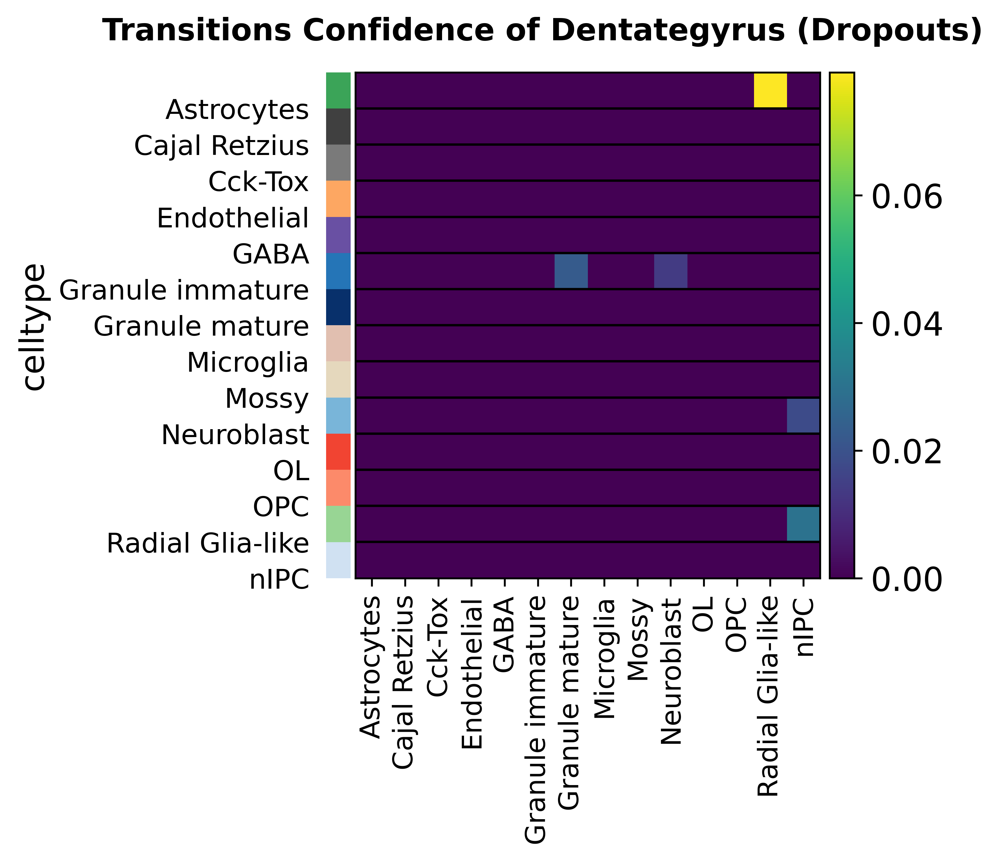

In [64]:
from anndata import AnnData
delete_transitions_adata = AnnData(delete_transitions_Dentategyrus)
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs.index
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs['celltype'].astype('category')
delete_transitions_adata.uns['celltype_colors'] = Dentategyrus.uns['clusters_colors']

sc.pl.heatmap(delete_transitions_adata,
              var_names=delete_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of Dentategyrus (Dropouts)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_Dentategyrus_deleted.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [65]:
interpolated_transitions_Dentategyrus=pd.DataFrame(Dentategyrus_interpolated.uns['paga']['transitions_confidence'].toarray(),
            index=Dentategyrus_interpolated.obs['clusters'].cat.categories,
            columns=Dentategyrus_interpolated.obs['clusters'].cat.categories)
print(interpolated_transitions_Dentategyrus)

                  Astrocytes  Cajal Retzius  Cck-Tox  Endothelial  GABA  \
Astrocytes               0.0            0.0      0.0     0.000000   0.0   
Cajal Retzius            0.0            0.0      0.0     0.000000   0.0   
Cck-Tox                  0.0            0.0      0.0     0.000000   0.0   
Endothelial              0.0            0.0      0.0     0.000000   0.0   
GABA                     0.0            0.0      0.0     0.000000   0.0   
Granule immature         0.0            0.0      0.0     0.012303   0.0   
Granule mature           0.0            0.0      0.0     0.000000   0.0   
Microglia                0.0            0.0      0.0     0.000000   0.0   
Mossy                    0.0            0.0      0.0     0.000000   0.0   
Neuroblast               0.0            0.0      0.0     0.000000   0.0   
OL                       0.0            0.0      0.0     0.000000   0.0   
OPC                      0.0            0.0      0.0     0.000000   0.0   
Radial Glia-like         

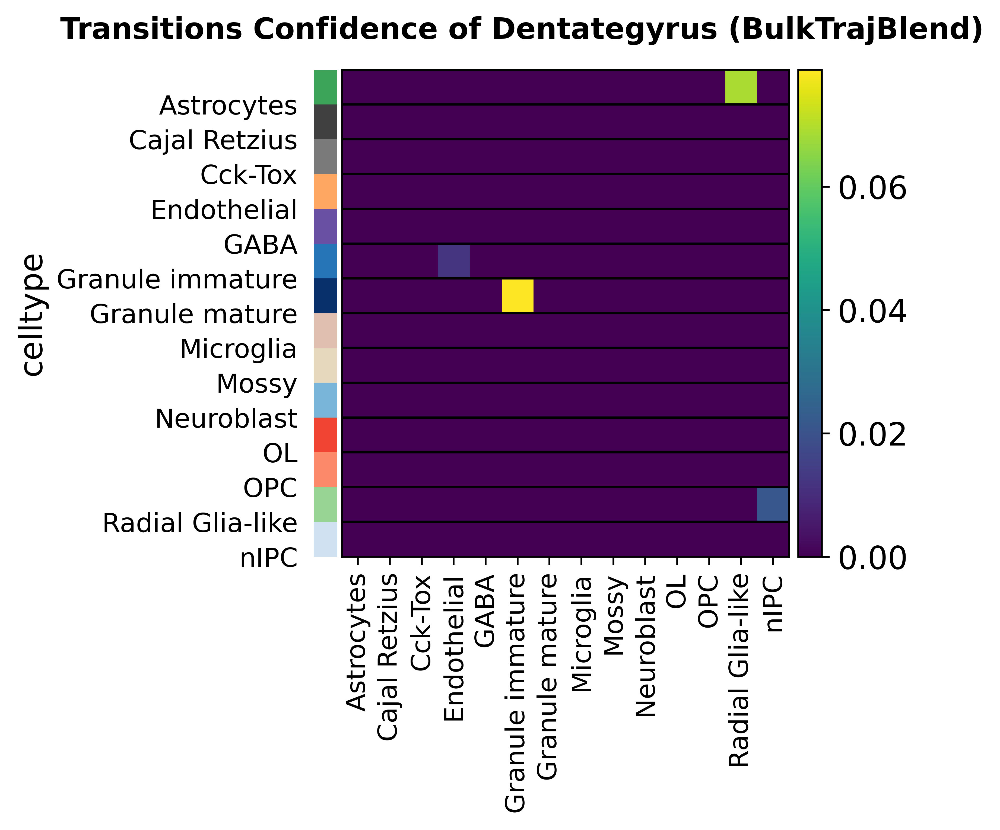

In [66]:
from anndata import AnnData
interpolated_transitions_adata = AnnData(interpolated_transitions_Dentategyrus)
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs.index
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs['celltype'].astype('category')
interpolated_transitions_adata.uns['celltype_colors'] = Dentategyrus.uns['clusters_colors']

sc.pl.heatmap(interpolated_transitions_adata,
              var_names=interpolated_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of Dentategyrus (BulkTrajBlend)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_Dentategyrus_interpolated.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [67]:
import numpy as np
Dentategyrus_delete_cal=np.var(Dentategyrus_deleted.obs.loc[Dentategyrus_deleted.obs['clusters']=='Granule immature','pt_via'])
Dentategyrus_raw_cal=np.var(Dentategyrus_raw.obs.loc[Dentategyrus_raw.obs['clusters']=='Granule immature','pt_via'])
Dentategyrus_after_cal=np.var(Dentategyrus_interpolated.obs.loc[Dentategyrus_interpolated.obs['clusters']=='Granule immature','pt_via'])

print(Dentategyrus_raw_cal)
print(Dentategyrus_delete_cal)
print(Dentategyrus_after_cal)

0.014992616310395708
0.008615620398361386
0.009741853435273364


## BoneMarrow

In [68]:
import pandas as pd
raw_transitions_BoneMarrow=pd.DataFrame(BoneMarrow_raw.uns['paga']['transitions_confidence'].toarray(),
            index=BoneMarrow_raw.obs['clusters'].cat.categories,
            columns=BoneMarrow_raw.obs['clusters'].cat.categories)
print(raw_transitions_BoneMarrow)

               HSC_1     HSC_2     Ery_1  Mono_1  Precursors       CLP  \
HSC_1       0.000000  0.000000  0.000000     0.0         0.0  0.000000   
HSC_2       0.106846  0.000000  0.000000     0.0         0.0  0.000000   
Ery_1       0.000000  0.000000  0.000000     0.0         0.0  0.023266   
Mono_1      0.000000  0.000000  0.000000     0.0         0.0  0.000000   
Precursors  0.000000  0.087128  0.000000     0.0         0.0  0.000000   
CLP         0.000000  0.083891  0.000000     0.0         0.0  0.000000   
Mono_2      0.000000  0.016417  0.000000     0.0         0.0  0.000000   
DCs         0.000000  0.000000  0.000000     0.0         0.0  0.000000   
Ery_2       0.000000  0.000000  0.046606     0.0         0.0  0.000000   
Mega        0.000000  0.000000  0.013161     0.0         0.0  0.000000   

              Mono_2  DCs  Ery_2  Mega  
HSC_1       0.000000  0.0    0.0   0.0  
HSC_2       0.000000  0.0    0.0   0.0  
Ery_1       0.000000  0.0    0.0   0.0  
Mono_1      0.025240 

In [69]:
new_order = [
    'HSC_1','HSC_2','Ery_1','Mono_1','Precursors',
    'CLP','Mono_2','DCs','Ery_2','Mega',
]


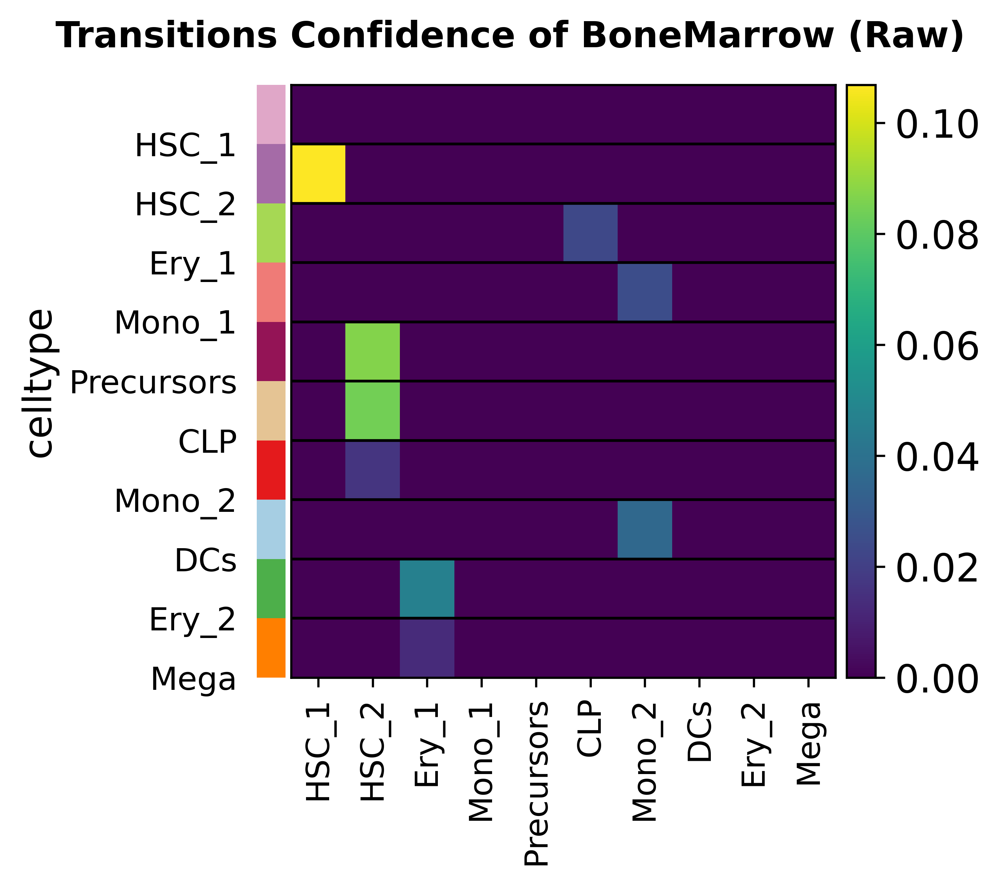

In [70]:
from anndata import AnnData
raw_transitions_adata = AnnData(raw_transitions_BoneMarrow)
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs.index
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs['celltype'].astype('category')
raw_transitions_adata.uns['celltype_colors'] = BoneMarrow.uns['clusters_colors']
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs['celltype'].cat.reorder_categories(new_order)

sc.pl.heatmap(raw_transitions_adata,
              var_names=raw_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of BoneMarrow (Raw)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_BoneMarrow_raw.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [71]:
delete_transitions_BoneMarrow=pd.DataFrame(BoneMarrow_deleted.uns['paga']['transitions_confidence'].toarray(),
            index=BoneMarrow_deleted.obs['clusters'].cat.categories,
            columns=BoneMarrow_deleted.obs['clusters'].cat.categories)
print(delete_transitions_BoneMarrow)

               HSC_1     HSC_2     Ery_1    Mono_1  Precursors  CLP    Mono_2  \
HSC_1       0.000000  0.000000  0.000000  0.000000    0.000000  0.0  0.000000   
HSC_2       0.157940  0.000000  0.000000  0.000000    0.000000  0.0  0.000000   
Ery_1       0.031913  0.000000  0.000000  0.000000    0.000000  0.0  0.000000   
Mono_1      0.000000  0.000000  0.000000  0.000000    0.000000  0.0  0.000000   
Precursors  0.000000  0.105915  0.000000  0.031490    0.000000  0.0  0.000000   
CLP         0.000000  0.000000  0.000000  0.000000    0.153308  0.0  0.000000   
Mono_2      0.000000  0.000000  0.000000  0.056342    0.000000  0.0  0.000000   
DCs         0.000000  0.000000  0.000000  0.000000    0.000000  0.0  0.048446   
Ery_2       0.000000  0.000000  0.081486  0.000000    0.000000  0.0  0.000000   
Mega        0.000000  0.000000  0.020368  0.000000    0.000000  0.0  0.000000   

            DCs  Ery_2  Mega  
HSC_1       0.0    0.0   0.0  
HSC_2       0.0    0.0   0.0  
Ery_1       0.0

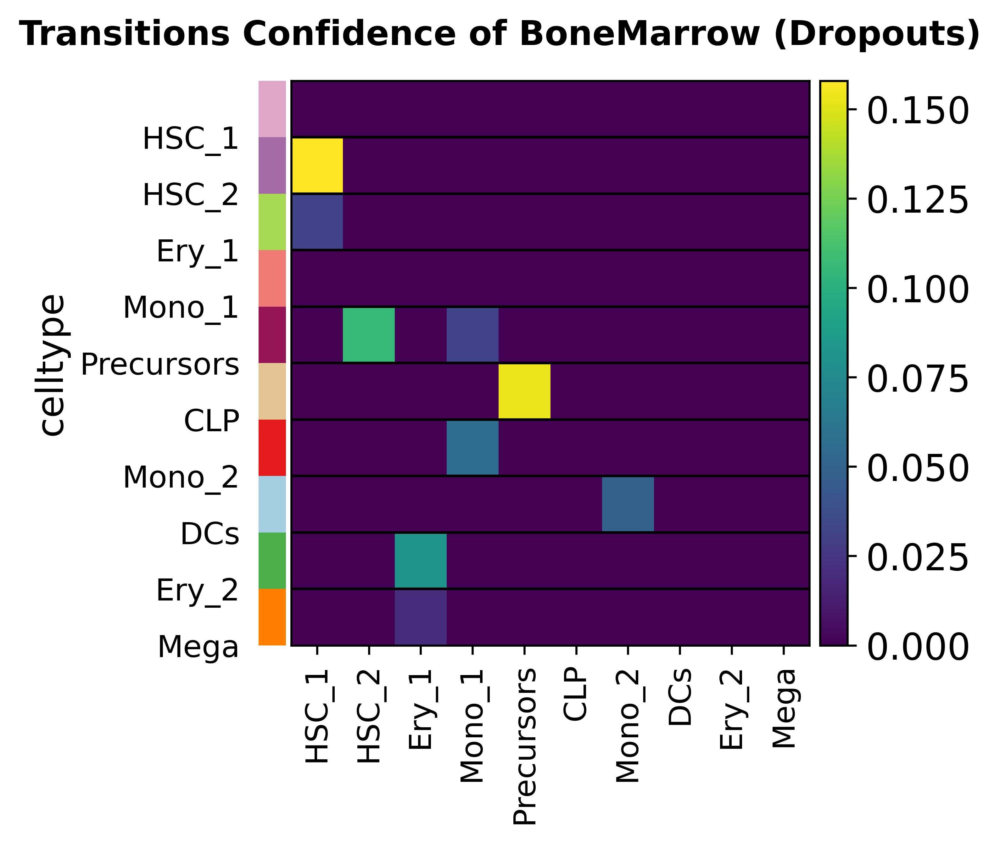

In [72]:
from anndata import AnnData
delete_transitions_adata = AnnData(delete_transitions_BoneMarrow)
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs.index
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs['celltype'].astype('category')
delete_transitions_adata.uns['celltype_colors'] = BoneMarrow.uns['clusters_colors']
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs['celltype'].cat.reorder_categories(new_order)

sc.pl.heatmap(delete_transitions_adata,
              var_names=delete_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of BoneMarrow (Dropouts)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_BoneMarrow_deleted.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [73]:
interpolated_transitions_BoneMarrow=pd.DataFrame(BoneMarrow_interpolated.uns['paga']['transitions_confidence'].toarray(),
            index=BoneMarrow_interpolated.obs['clusters'].cat.categories,
            columns=BoneMarrow_interpolated.obs['clusters'].cat.categories)
print(interpolated_transitions_BoneMarrow)

               HSC_1     HSC_2     Ery_1  Mono_1  Precursors  CLP  Mono_2  \
HSC_1       0.000000  0.000000  0.000000     0.0    0.000000  0.0     0.0   
HSC_2       0.351557  0.000000  0.000000     0.0    0.000000  0.0     0.0   
Ery_1       0.000000  0.000000  0.000000     0.0    0.015870  0.0     0.0   
Mono_1      0.000000  0.000000  0.000000     0.0    0.087729  0.0     0.0   
Precursors  0.000000  0.063820  0.000000     0.0    0.000000  0.0     0.0   
CLP         0.000000  0.000000  0.000000     0.0    0.077001  0.0     0.0   
Mono_2      0.000000  0.018967  0.000000     0.0    0.000000  0.0     0.0   
DCs         0.000000  0.000000  0.000000     0.0    0.026107  0.0     0.0   
Ery_2       0.000000  0.000000  0.057388     0.0    0.000000  0.0     0.0   
Mega        0.000000  0.000000  0.000000     0.0    0.000000  0.0     0.0   

            DCs  Ery_2  Mega  
HSC_1       0.0    0.0   0.0  
HSC_2       0.0    0.0   0.0  
Ery_1       0.0    0.0   0.0  
Mono_1      0.0    0.0   0.0

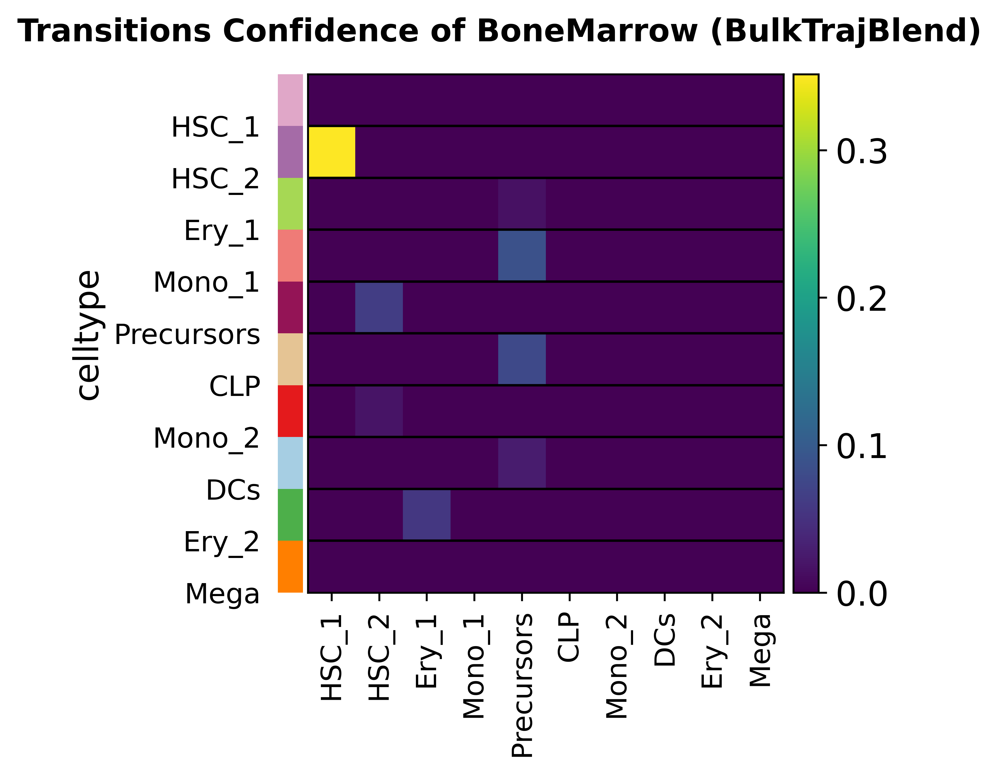

In [74]:
from anndata import AnnData
interpolated_transitions_adata = AnnData(interpolated_transitions_BoneMarrow)
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs.index
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs['celltype'].astype('category')
interpolated_transitions_adata.uns['celltype_colors'] = BoneMarrow.uns['clusters_colors']
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs['celltype'].cat.reorder_categories(new_order)

sc.pl.heatmap(interpolated_transitions_adata,
              var_names=interpolated_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of BoneMarrow (BulkTrajBlend)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_BoneMarrow_interpolated.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [75]:
import numpy as np
BoneMarrow_delete_cal=np.var(BoneMarrow_deleted.obs.loc[BoneMarrow_deleted.obs['clusters']=='HSC_2','pt_via'])
BoneMarrow_raw_cal=np.var(BoneMarrow_raw.obs.loc[BoneMarrow_raw.obs['clusters']=='HSC_2','pt_via'])
BoneMarrow_after_cal=np.var(BoneMarrow_interpolated.obs.loc[BoneMarrow_interpolated.obs['clusters']=='HSC_2','pt_via'])

print(BoneMarrow_raw_cal)
print(BoneMarrow_delete_cal)
print(BoneMarrow_after_cal)

0.013455270553426586
0.023402731649658497
0.013950363771511438


## Pancreas

In [76]:
import pandas as pd
raw_transitions_Pancreas=pd.DataFrame(Pancreas_raw.uns['paga']['transitions_confidence'].toarray(),
            index=Pancreas_raw.obs['clusters'].cat.categories,
            columns=Pancreas_raw.obs['clusters'].cat.categories)
print(raw_transitions_Pancreas)

                 Ductal  Ngn3 low EP  Ngn3 high EP  Pre-endocrine      Beta  \
Ductal         0.000000          0.0      0.000000       0.000000  0.000000   
Ngn3 low EP    0.017827          0.0      0.000000       0.000000  0.000000   
Ngn3 high EP   0.000000          0.0      0.000000       0.000000  0.000000   
Pre-endocrine  0.000000          0.0      0.039579       0.000000  0.000000   
Beta           0.000000          0.0      0.000000       0.037532  0.000000   
Alpha          0.000000          0.0      0.000000       0.000000  0.060268   
Delta          0.000000          0.0      0.000000       0.000000  0.000000   
Epsilon        0.000000          0.0      0.000000       0.000000  0.000000   

               Alpha  Delta  Epsilon  
Ductal           0.0    0.0      0.0  
Ngn3 low EP      0.0    0.0      0.0  
Ngn3 high EP     0.0    0.0      0.0  
Pre-endocrine    0.0    0.0      0.0  
Beta             0.0    0.0      0.0  
Alpha            0.0    0.0      0.0  
Delta          

In [77]:
new_order = ['Ductal','Ngn3 low EP','Ngn3 high EP','Pre-endocrine','Beta','Alpha','Delta','Epsilon']

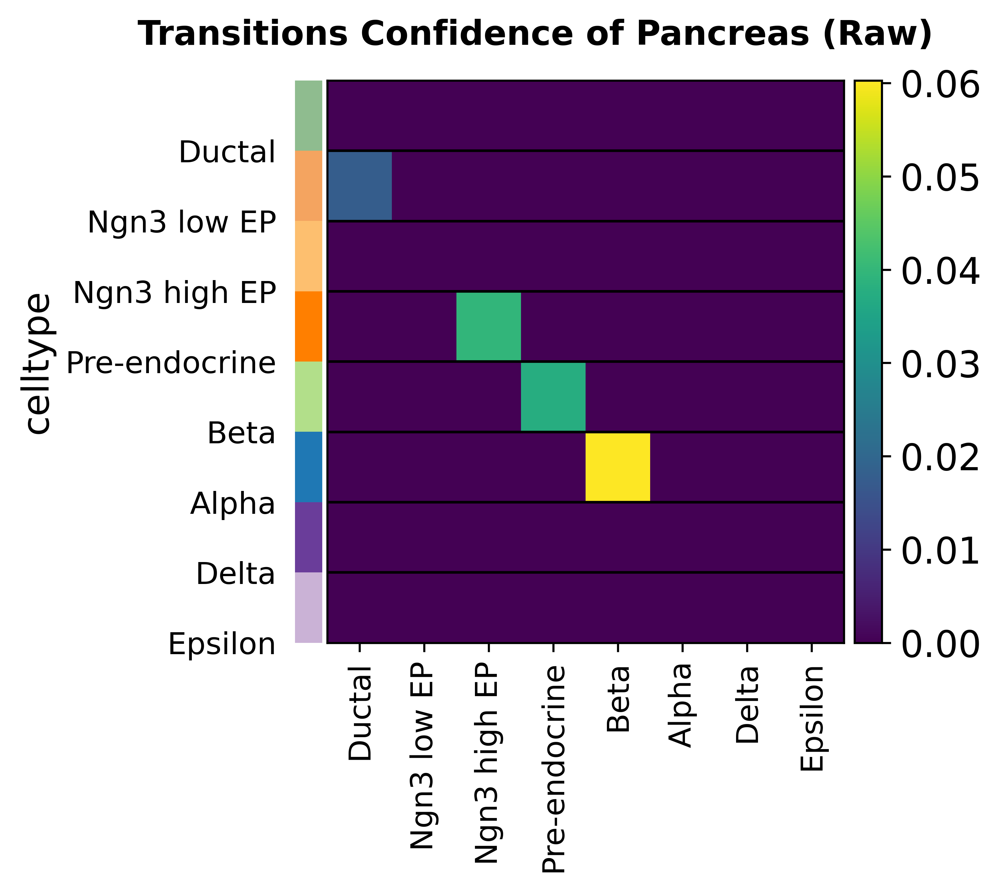

In [78]:
from anndata import AnnData
raw_transitions_adata = AnnData(raw_transitions_Pancreas)
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs.index
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs['celltype'].astype('category')
raw_transitions_adata.uns['celltype_colors'] = Pancreas.uns['clusters_colors']
raw_transitions_adata.obs['celltype'] = raw_transitions_adata.obs['celltype'].cat.reorder_categories(new_order)


sc.pl.heatmap(raw_transitions_adata,
              var_names=raw_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of Pancreas (Raw)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_Pancreas_raw.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [79]:
delete_transitions_Pancreas=pd.DataFrame(Pancreas_deleted.uns['paga']['transitions_confidence'].toarray(),
            index=Pancreas_deleted.obs['clusters'].cat.categories,
            columns=Pancreas_deleted.obs['clusters'].cat.categories)
print(delete_transitions_Pancreas)

                 Ductal  Ngn3 low EP  Ngn3 high EP  Pre-endocrine  Beta  \
Ductal         0.000000          0.0           0.0       0.000000   0.0   
Ngn3 low EP    0.011703          0.0           0.0       0.000000   0.0   
Ngn3 high EP   0.000000          0.0           0.0       0.000000   0.0   
Pre-endocrine  0.000000          0.0           0.0       0.000000   0.0   
Beta           0.000000          0.0           0.0       0.067399   0.0   
Alpha          0.000000          0.0           0.0       0.041103   0.0   
Delta          0.000000          0.0           0.0       0.000000   0.0   
Epsilon        0.000000          0.0           0.0       0.000000   0.0   

               Alpha    Delta  Epsilon  
Ductal           0.0  0.00000  0.00000  
Ngn3 low EP      0.0  0.00000  0.00000  
Ngn3 high EP     0.0  0.00000  0.00000  
Pre-endocrine    0.0  0.01179  0.00000  
Beta             0.0  0.00000  0.00000  
Alpha            0.0  0.00000  0.01454  
Delta            0.0  0.00000  0.0000

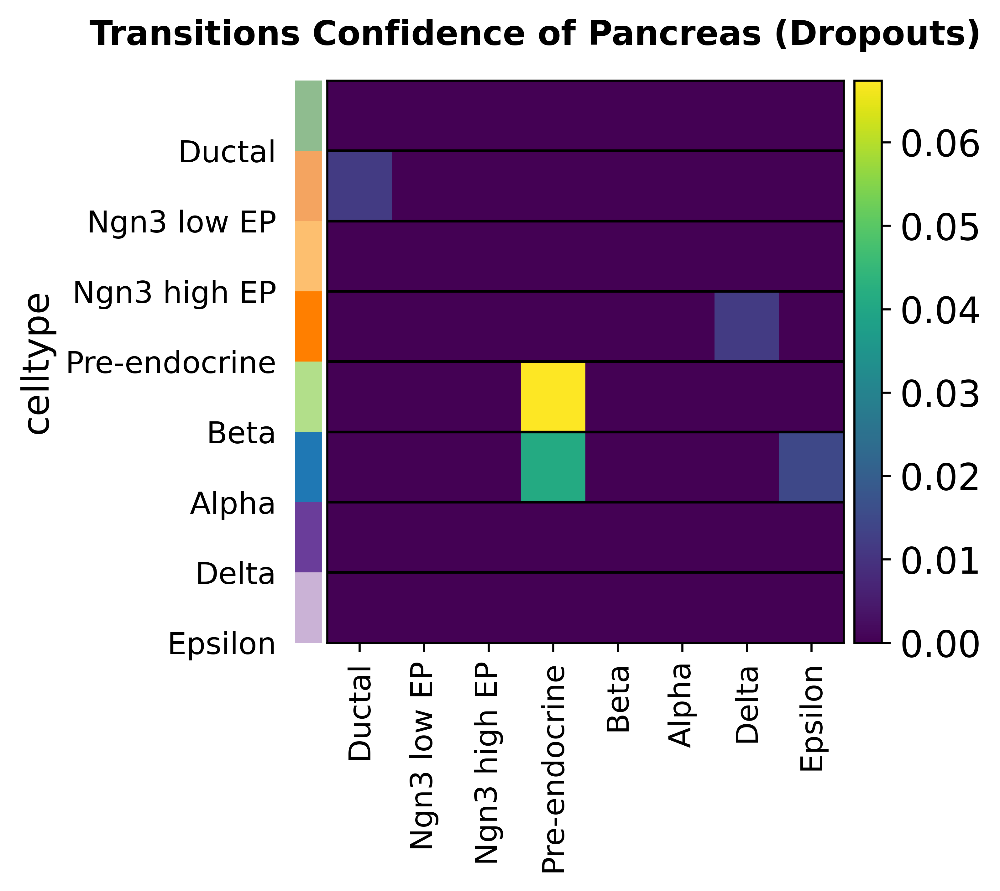

In [80]:
from anndata import AnnData
delete_transitions_adata = AnnData(delete_transitions_Pancreas)
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs.index
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs['celltype'].astype('category')
delete_transitions_adata.uns['celltype_colors'] = Pancreas.uns['clusters_colors']
delete_transitions_adata.obs['celltype'] = delete_transitions_adata.obs['celltype'].cat.reorder_categories(new_order)

sc.pl.heatmap(delete_transitions_adata,
              var_names=delete_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of Pancreas (Dropouts)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_Pancreas_deleted.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [81]:
interpolated_transitions_Pancreas=pd.DataFrame(Pancreas_interpolated.uns['paga']['transitions_confidence'].toarray(),
            index=Pancreas_interpolated.obs['clusters'].cat.categories,
            columns=Pancreas_interpolated.obs['clusters'].cat.categories)
print(interpolated_transitions_Pancreas)

                 Ductal  Ngn3 low EP  Ngn3 high EP  Pre-endocrine  Beta  \
Ductal         0.000000          0.0      0.000000       0.000000   0.0   
Ngn3 low EP    0.016738          0.0      0.000000       0.000000   0.0   
Ngn3 high EP   0.000000          0.0      0.000000       0.000000   0.0   
Pre-endocrine  0.000000          0.0      0.034886       0.000000   0.0   
Beta           0.000000          0.0      0.000000       0.058348   0.0   
Alpha          0.000000          0.0      0.000000       0.048850   0.0   
Delta          0.000000          0.0      0.000000       0.000000   0.0   
Epsilon        0.000000          0.0      0.000000       0.000000   0.0   

               Alpha     Delta  Epsilon  
Ductal           0.0  0.000000      0.0  
Ngn3 low EP      0.0  0.000000      0.0  
Ngn3 high EP     0.0  0.000000      0.0  
Pre-endocrine    0.0  0.000000      0.0  
Beta             0.0  0.057771      0.0  
Alpha            0.0  0.000000      0.0  
Delta            0.0  0.000000

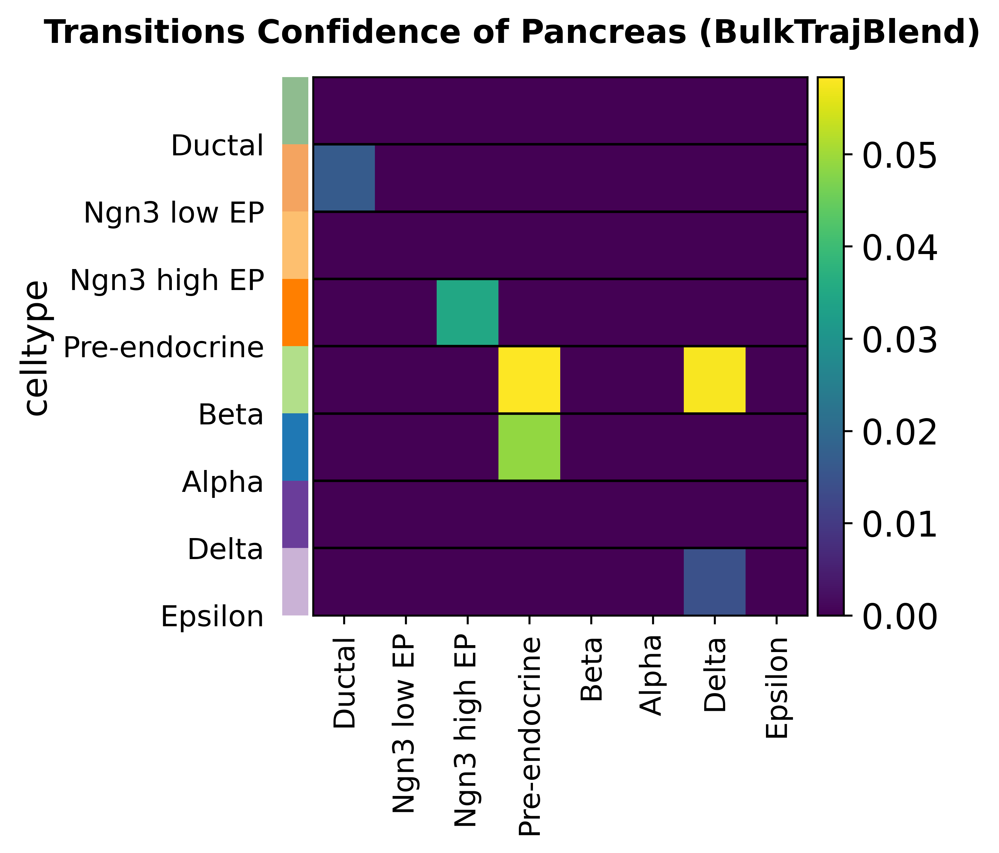

In [82]:
from anndata import AnnData
interpolated_transitions_adata = AnnData(interpolated_transitions_Pancreas)
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs.index
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs['celltype'].astype('category')
interpolated_transitions_adata.uns['celltype_colors'] = Pancreas.uns['clusters_colors']
interpolated_transitions_adata.obs['celltype'] = interpolated_transitions_adata.obs['celltype'].cat.reorder_categories(new_order)

sc.pl.heatmap(interpolated_transitions_adata,
              var_names=interpolated_transitions_adata.var.index,
              groupby='celltype',figsize=(4,4),cmap='viridis',show=False,)
fig = plt.gcf()

# 修改标题
fig.suptitle('Transitions Confidence of Pancreas (BulkTrajBlend)', fontsize=13,fontweight='bold')
fig.savefig('figures/Transitions_Pancreas_interpolated.pdf',dpi=300,bbox_inches = 'tight')
plt.show()

In [83]:
import numpy as np
Pancreas_delete_cal=np.var(Pancreas_deleted.obs.loc[Pancreas_deleted.obs['clusters']=='Ngn3 high EP','pt_via'])
Pancreas_raw_cal=np.var(Pancreas_raw.obs.loc[Pancreas_raw.obs['clusters']=='Ngn3 high EP','pt_via'])
Pancreas_after_cal=np.var(Pancreas_interpolated.obs.loc[Pancreas_interpolated.obs['clusters']=='Ngn3 high EP','pt_via'])

print(Pancreas_raw_cal)
print(Pancreas_delete_cal)
print(Pancreas_after_cal)

0.01739550717458245
0.0035603450552829717
0.009680397729541528


## total plot

In [84]:
import pandas as pd

# 创建包含数据的字典
Variance = {
    'Variance': [Pancreas_raw_cal, Pancreas_delete_cal, Pancreas_after_cal, BoneMarrow_raw_cal, BoneMarrow_delete_cal, BoneMarrow_after_cal, Dentategyrus_raw_cal, Dentategyrus_delete_cal, Dentategyrus_after_cal],
    'Celltype': ['Pancreas', 'Pancreas', 'Pancreas', 'BoneMarrow', 'BoneMarrow', 'BoneMarrow', 'Dentategyrus', 'Dentategyrus', 'Dentategyrus'],
    'Type': ['Raw', 'Dropouts', 'BulkTrajBlend', 'Raw', 'Dropouts', 'BulkTrajBlend', 'Raw', 'Dropouts', 'BulkTrajBlend']
}

# 创建 DataFrame
Variance = pd.DataFrame(Variance)
Variance



,Variance,Celltype,Type
0,0.017396,Pancreas,Raw
1,0.003560,Pancreas,Dropouts
2,0.009680,Pancreas,BulkTrajBlend
3,0.013455,BoneMarrow,Raw
4,0.023403,BoneMarrow,Dropouts
5,0.013950,BoneMarrow,BulkTrajBlend
6,0.014993,Dentategyrus,Raw
7,0.008616,Dentategyrus,Dropouts
8,0.009742,Dentategyrus,BulkTrajBlend


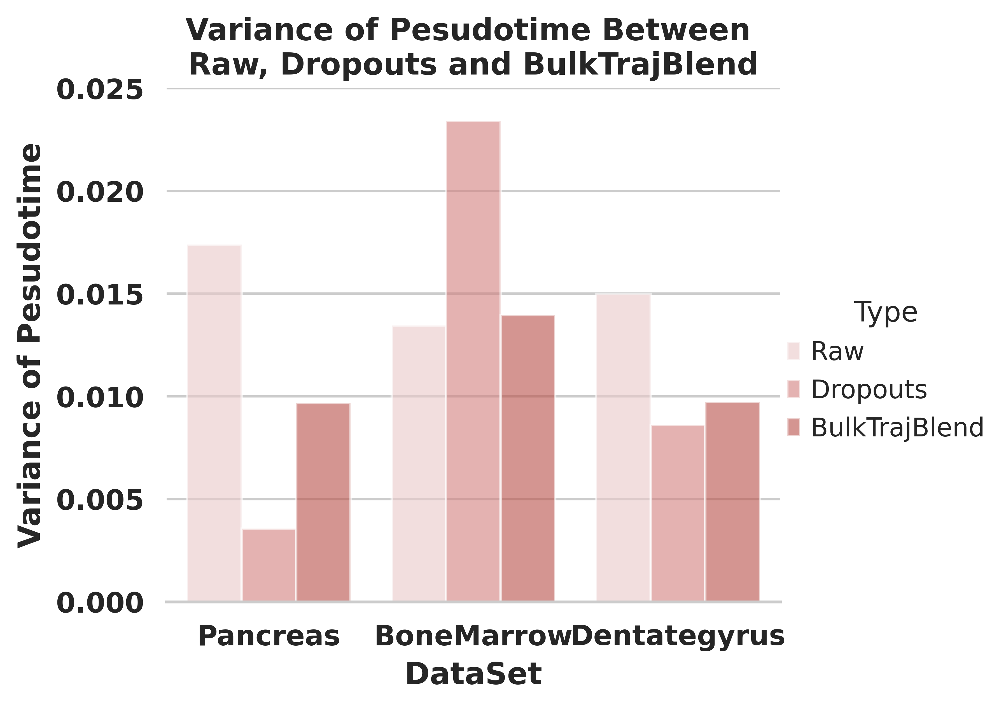

In [88]:
import seaborn as sns
sns.set_theme(style="whitegrid")

# Draw a nested barplot by species and sex
g = sns.catplot(
    data=Variance, kind="bar",
    x="Celltype", y="Variance", hue="Type",
    errorbar=None, alpha=.6, height=6,palette=ov.utils.red_color[:]
)

g.despine(left=True)
g.set_axis_labels("DataSet", "Variance of Pesudotime",fontsize=13,fontweight='bold')
g.legend.set_title("Type") #The Variance of Pesudotime Between Dropouts and BulkTrajBlend
g.fig.set_size_inches(5, 4)

g.legend.set_bbox_to_anchor((1.2,0.5))
g.set_xticklabels(fontsize=12,fontweight='bold')
g.set_yticklabels(fontsize=12,fontweight='bold')

plt.tight_layout()
# Set the title of the entire plot
plt.title("Variance of Pesudotime Between \nRaw, Dropouts and BulkTrajBlend",fontsize=13,fontweight='bold')


g.savefig("figures/Variances.pdf",dpi=300,bbox_inches='tight')  # Change "your_plot.pdf" to the desired filename and format


In [86]:
import pandas as pd

Transitions = {
    'Transitions Confidence': [float(raw_transitions_Pancreas.T.loc['Ngn3 high EP','Pre-endocrine']),
          float(delete_transitions_Pancreas.T.loc['Ngn3 high EP','Pre-endocrine']),
          float(interpolated_transitions_Pancreas.T.loc['Ngn3 high EP','Pre-endocrine']),
          float(raw_transitions_BoneMarrow.T.loc['HSC_2','Mono_2']),
          float(delete_transitions_BoneMarrow.T.loc['HSC_2','Mono_2']),
          float(interpolated_transitions_BoneMarrow.T.loc['HSC_2','Mono_2']),
          float(raw_transitions_Dentategyrus.T.loc['Granule immature','Granule mature']),
          float(delete_transitions_Dentategyrus.T.loc['Granule immature','Granule mature']),
          float(interpolated_transitions_Dentategyrus.T.loc['Granule immature','Granule mature']),
    ],
    #'Type': ['Ngn3 high EP transfers to Pre-endocrine', 'Ngn3 high EP transfers to Pre-endocrine', 'Ngn3 high EP transfers to Pre-endocrine',
    #        'HSC_2 transfers to Precursors', 'HSC_2 transfers to Precursors', 'HSC_2 transfers to Precursors',
    #          'Granule Immature transfers to Granule Mature', 'Granule Immature transfers to Granule Mature',
    #             'Granule Immature transfers to Granule Mature',],
    'Celltype': ['Pancreas', 'Pancreas', 'Pancreas', 'BoneMarrow',
            'BoneMarrow', 'BoneMarrow', 'Dentategyrus', 'Dentategyrus', 'Dentategyrus'],
    'Type': ['Raw', 'Dropouts', 'BulkTrajBlend', 'Raw', 'Dropouts', 'BulkTrajBlend', 'Raw', 'Dropouts', 'BulkTrajBlend']

}

Transitions = pd.DataFrame(Transitions)
Transitions



,Transitions Confidence,Celltype,Type
0,0.039579,Pancreas,Raw
1,0.000000,Pancreas,Dropouts
2,0.034886,Pancreas,BulkTrajBlend
3,0.016417,BoneMarrow,Raw
4,0.000000,BoneMarrow,Dropouts
5,0.018967,BoneMarrow,BulkTrajBlend
6,0.084744,Dentategyrus,Raw
7,0.000000,Dentategyrus,Dropouts
8,0.078958,Dentategyrus,BulkTrajBlend


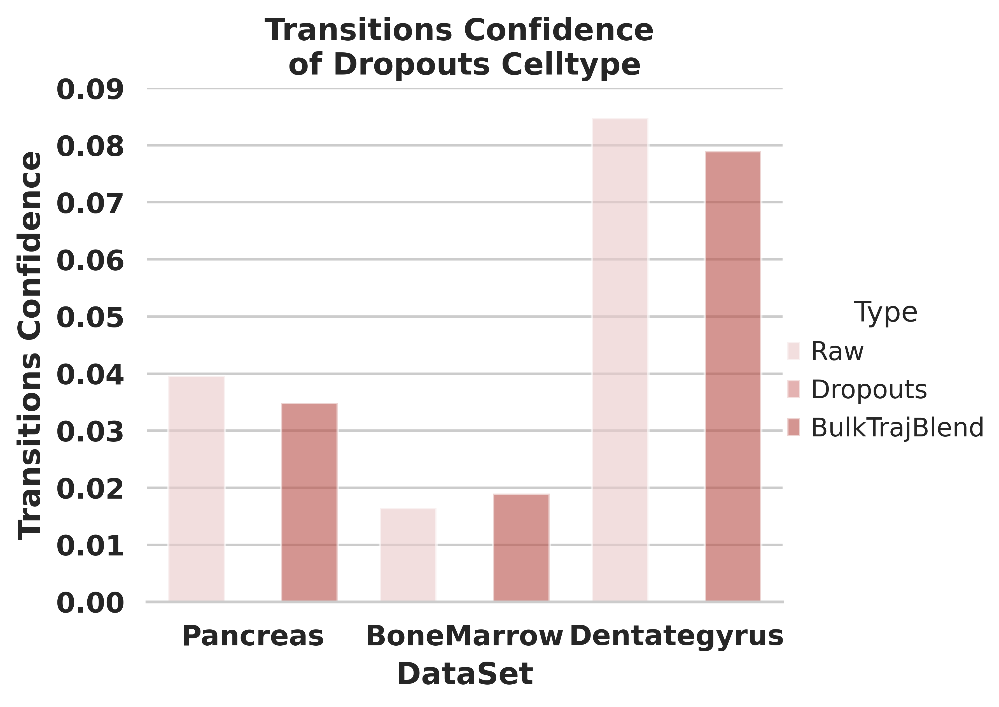

In [87]:
import seaborn as sns
sns.set_theme(style="whitegrid")

# Draw a nested barplot by species and sex
g = sns.catplot(
    data=Transitions, kind="bar",
    x="Celltype", y='Transitions Confidence', hue="Type",
    errorbar=None, palette=ov.utils.red_color[:], alpha=.6, height=6
)


g.despine(left=True)
g.set_axis_labels("DataSet", "Transitions Confidence",fontsize=13,fontweight='bold')
g.legend.set_title("Type") #The Variance of Pesudotime Between Dropouts and BulkTrajBlend
g.fig.set_size_inches(5, 4)

g.legend.set_bbox_to_anchor((1.2,0.5))
g.set_xticklabels(fontsize=12,fontweight='bold')
g.set_yticklabels(fontsize=12,fontweight='bold')

plt.tight_layout()
# Set the title of the entire plot
plt.title("Transitions Confidence \nof Dropouts Celltype",fontsize=13,fontweight='bold')


g.savefig("figures/Transitions.pdf",dpi=300,bbox_inches='tight')  # Change "your_plot.pdf" to the desired filename and format
